In [ ]:
# Run this cell to mount your Google Drive.

from IPython.display import clear_output, Image
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


# Imports

In [ ]:
# !pip install rlcard
!pip install rlcard[torch]
!pip install rlcard[tensorflow]

clear_output()

In [ ]:
import torch
import numpy as np
import tensorflow
import os
import importlib

# path
pth = '/content/drive/MyDrive/Colab Notebooks/Thesis'

%cd /content/drive/My Drive/Colab Notebooks/Thesis/SupervisedLearning

from MLP import *
from models import *

# remove pycache
%cd /content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/agents/
%rm -r __pycache__
%cd /content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/envs/
%rm -r __pycache__
%cd /content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/games/
%rm -r __pycache__
%cd /content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/utils/
%rm -r __pycache__
%cd /content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/
%rm -r __pycache__

%cd /content/drive/My Drive/Colab Notebooks/Thesis/dqn

try:
    importlib.reload(rlcard)
    importlib.reload(rlcard.utils)
    importlib.reload(rlcard.agents.random_agent)
    importlib.reload(rlcard.agents.dqn_agent_pytorch)
    importlib.reload(rlcard.agents.simpleGinRummy_agent)
    importlib.reload(rlcard.games.gin_rummy.utils.scorers)
except:
    pass

import rlcard
from rlcard.utils import set_global_seed, tournament, tournament2
from rlcard.utils import Logger
from rlcard.agents.random_agent import RandomAgent
from rlcard.agents.dqn_agent_pytorch import DQNAgent
from rlcard.agents.simpleGinRummy_agent import SimpleGinRummyAgent

# different versions of payoff functions
from rlcard.games.gin_rummy.utils.scorers import *

%cd /content/drive/My Drive/Colab Notebooks/Thesis

/content/drive/My Drive/Colab Notebooks/Thesis/SupervisedLearning
/content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/agents
/content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/envs
rm: cannot remove '__pycache__': No such file or directory
/content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/games
rm: cannot remove '__pycache__': No such file or directory
/content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard/utils
/content/drive/My Drive/Colab Notebooks/Thesis/dqn/rlcard
/content/drive/My Drive/Colab Notebooks/Thesis/dqn
/content/drive/My Drive/Colab Notebooks/Thesis


# Model Parameters Search

All Models using:
- Hardcoded top layer weights, copy biases
- (all_states_all_actions_2hl_extra_knock_data_80K)
- default unless otherwise stated

BEST SO FAR
- replay_memory_size=200000,
- replay_memory_init_size=100000,
- update_target_estimator_every=,
- discount_factor=,
- epsilon_start=,
- epsilon_end=,
- epsilon_decay_steps=,
- batch_size=32,
- train_every=100000,
- learning_rate=,

In [ ]:
'''
Q-Learning algorithm for off-policy TD control using Function Approximation.
Finds the optimal greedy policy while following an epsilon-greedy policy.
Args:
    scope (str): The name of the DQN agent
    replay_memory_size (int): Size of the replay memory
    replay_memory_init_size (int): Number of random experiences to sample when initializing
      the reply memory.
    update_target_estimator_every (int): Copy parameters from the Q estimator to the
      target estimator every N steps
    discount_factor (float): Gamma discount factor
    epsilon_start (int): Chance to sample a random action when taking an action.
      Epsilon is decayed over time and this is the start value
    epsilon_end (int): The final minimum value of epsilon after decaying is done
    epsilon_decay_steps (int): Number of steps to decay epsilon over
    batch_size (int): Size of batches to sample from the replay memory
    evaluate_every (int): Evaluate every N steps
    action_num (int): The number of the actions
    state_space (list): The space of the state vector
    train_every (int): Train the network every X steps.
    mlp_layers (list): The layer number and the dimension of each layer in MLP
    learning_rate (float): The learning rate of the DQN agent.
    device (torch.device): whether to use the cpu or gpu
'''

# batch_size

- **TEST28: 32**
- TEST29: 64
- TEST30: 128
- TEST31: 256

using LR = 5e-7, train every 100 steps



## TEST28 - BS = 32

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST28'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 100

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

----------------------------------------
  timestep     |  461554
  reward       |  -0.1717
  Avg Turns    |  26.22
{'Gin': 6, 'Knock': 13, 'Other': 81, 'Avg Turns': 26.22}
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  461554
  reward       |  -0.26319999999999993
  Avg Turns    |  18.14
{'Gin': 1, 'Knock': 3, 'Other': 96, 'Avg Turns': 18.14}
----------------------------------------
INFO - Agent dqn, step 237100, rl-loss: 0.004507715813815594
Random:

----------------------------------------
  timestep     |  472684
  reward       |  0.40100000000000036
  Avg Turns    |  50.78
{'Gin': 28, 'Knock': 41, 'Other': 31, 'Avg Turns': 50.78}
----------------------------------------

Selfplay:

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

-----------------------------------

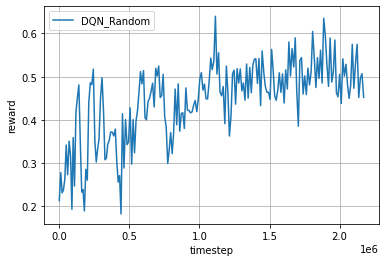

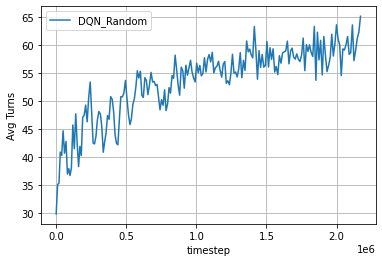

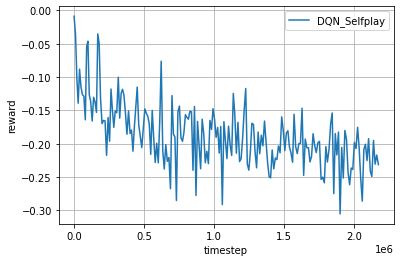

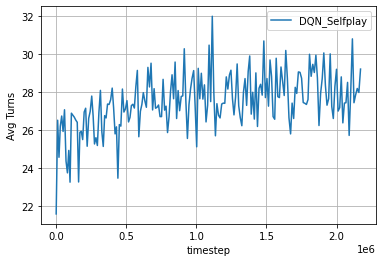

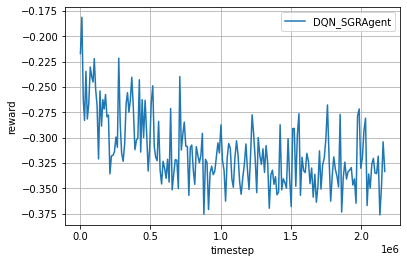

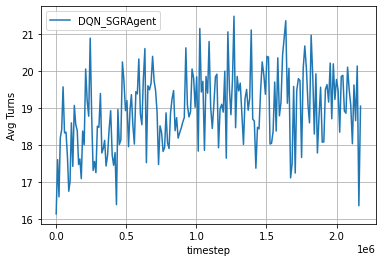

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 63.5, 'Gin': 36, 'Knock': 34, 'Other': 30}

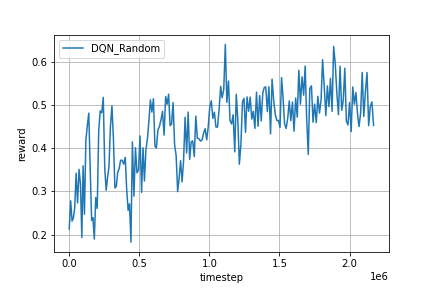

In [ ]:
Image(log_dir + '/rand_fig.png')

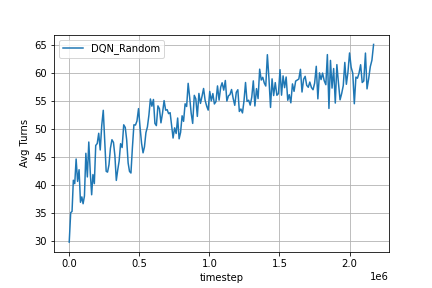

In [ ]:
Image(log_dir + '/rand_fig2.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)


Stuck in infinite loop... reset time

Stuck in infinite loop... reset time


{'Avg Turns': 29.44, 'Gin': 2, 'Knock': 7, 'Other': 91}

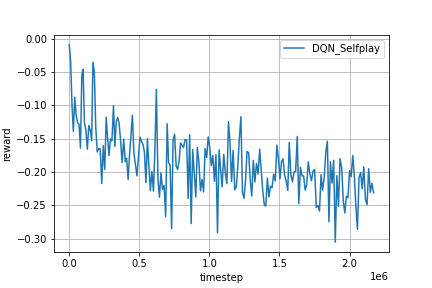

In [ ]:
Image(log_dir + '/self_fig.png')

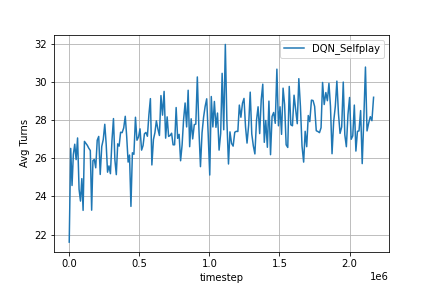

In [ ]:
Image(log_dir + '/self_fig2.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)


Stuck in infinite loop... reset time


{'Avg Turns': 19.14, 'Gin': 2, 'Knock': 3, 'Other': 95}

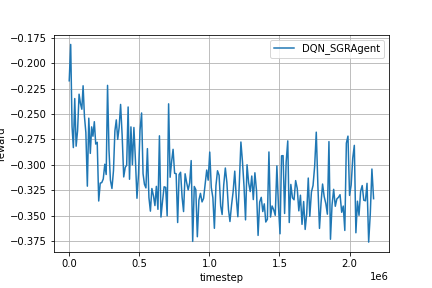

In [ ]:
Image(log_dir + '/sgr_fig.png')

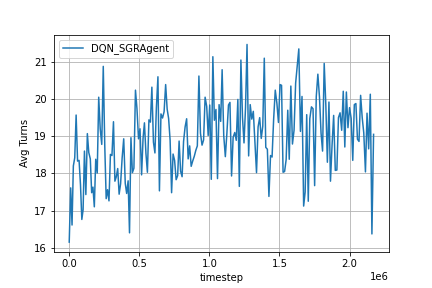

In [ ]:
Image(log_dir + '/sgr_fig2.png')

## TEST29 - BS = 64

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST29'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 64

# Train the agent every X steps
# default: 1
train_every = 100

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
  Avg Turns    |  46.6
{'Gin': 35, 'Knock': 28, 'Other': 37, 'Avg Turns': 46.6}
----------------------------------------

Selfplay:

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

----------------------------------------
  timestep     |  471952
  reward       |  -0.1575
  Avg Turns    |  25.64
{'Gin': 3, 'Knock': 16, 'Other': 81, 'Avg Turns': 25.64}
----------------------------------------

SGRAgent:

Stuck in infinite loop... reset time

----------------------------------------
  timestep     |  471952
  reward       |  -0.259
  Avg Turns    |  18.36
{'Gin': 0, 'Knock': 5, 'Other': 95, 'Avg Turns': 18.36}
----------------------------------------
INFO - Agent dqn, step 241900, rl-loss: 1.7800944988266565e-05
Random:

----------------------------------------
  timestep     |  482166
  reward       |  0.3513999999999999
  Avg Turns  

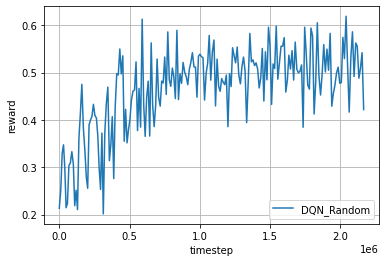

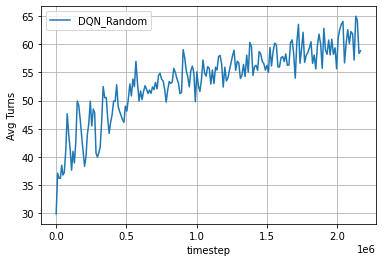

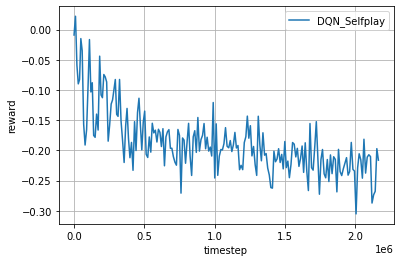

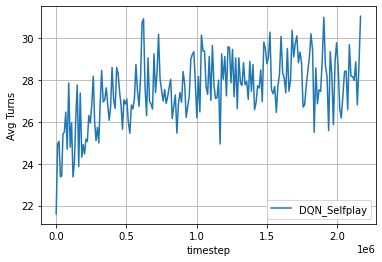

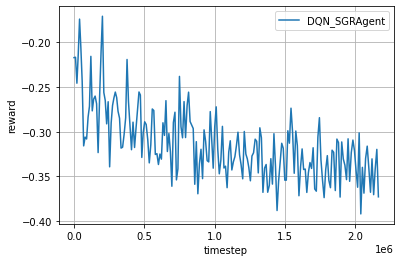

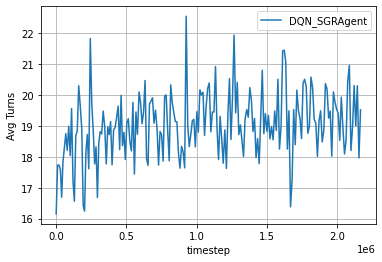

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 60.15, 'Gin': 46, 'Knock': 35, 'Other': 19}

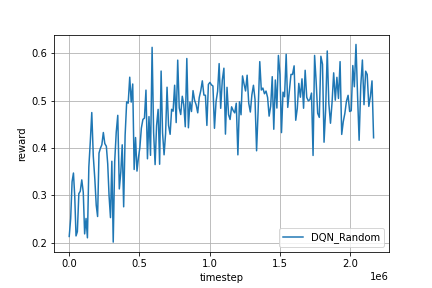

In [ ]:
Image(log_dir + '/rand_fig.png')

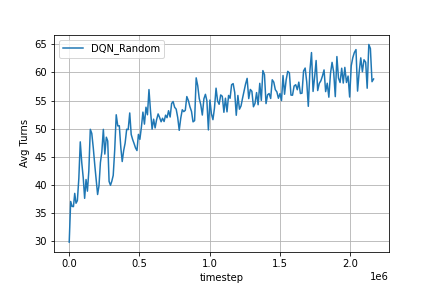

In [ ]:
Image(log_dir + '/rand_fig2.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 27.28, 'Gin': 1, 'Knock': 3, 'Other': 96}

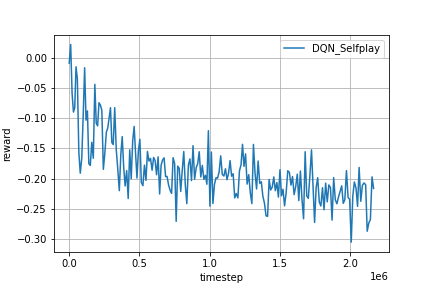

In [ ]:
Image(log_dir + '/self_fig.png')

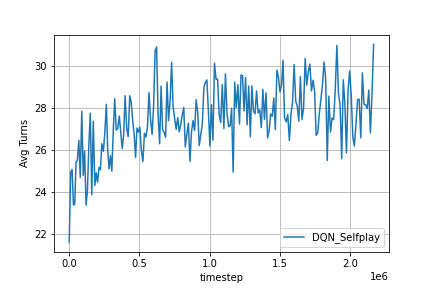

In [ ]:
Image(log_dir + '/self_fig2.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)


Stuck in infinite loop... reset time


{'Avg Turns': 18.64, 'Gin': 1, 'Knock': 4, 'Other': 95}

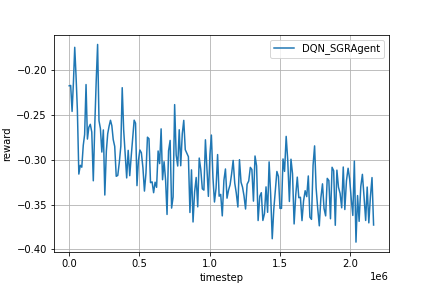

In [ ]:
Image(log_dir + '/sgr_fig.png')

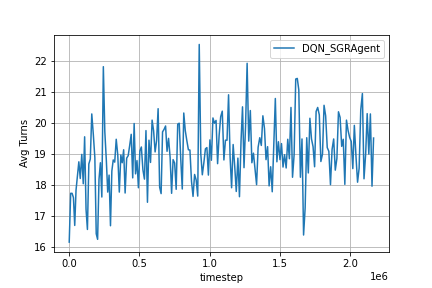

In [ ]:
Image(log_dir + '/sgr_fig2.png')

## TEST30 - BS = 128

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST30'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 128

# Train the agent every X steps
# default: 1
train_every = 100

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
----------------------------------------
  timestep     |  504237
  reward       |  0.3694999999999999
  Avg Turns    |  47.43
{'Gin': 27, 'Knock': 28, 'Other': 45, 'Avg Turns': 47.43}
----------------------------------------

Selfplay:

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

----------------------------------------
  timestep     |  504237
  reward       |  -0.14580000000000015
  Avg Turns    |  25.55
{'Gin': 4, 'Knock': 14, 'Other': 82, 'Avg Turns': 25.55}
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  504237
  reward       |  -0.31030

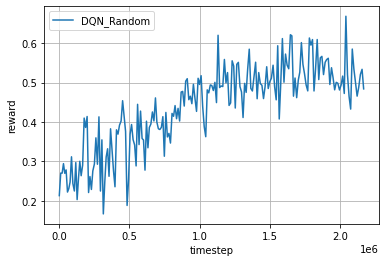

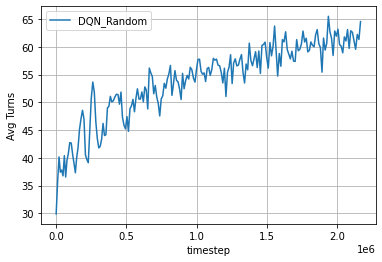

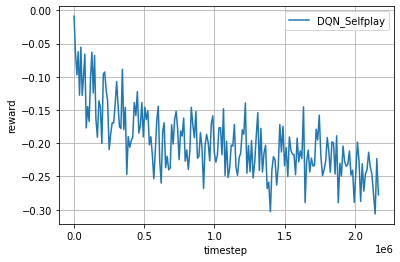

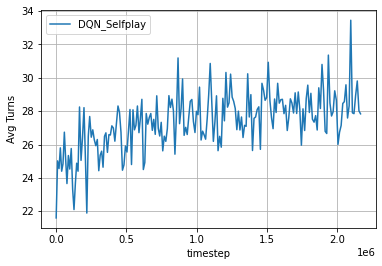

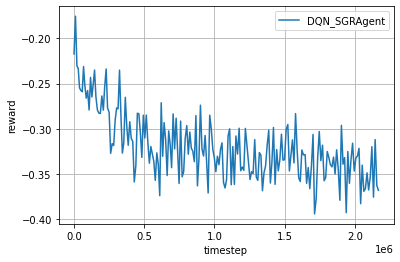

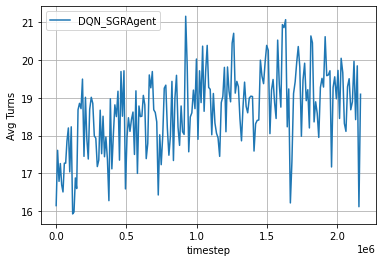

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 62.19, 'Gin': 55, 'Knock': 27, 'Other': 18}

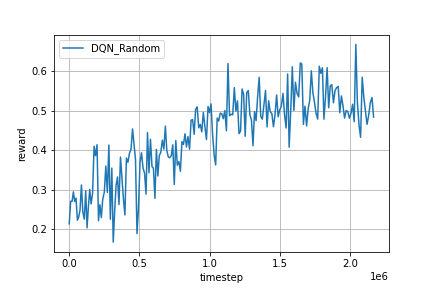

In [ ]:
Image(log_dir + '/rand_fig.png')

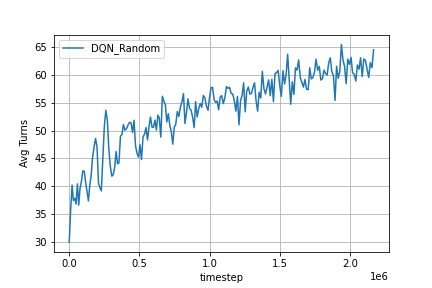

In [ ]:
Image(log_dir + '/rand_fig2.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)


Stuck in infinite loop... reset time


{'Avg Turns': 26.94, 'Gin': 1, 'Knock': 9, 'Other': 90}

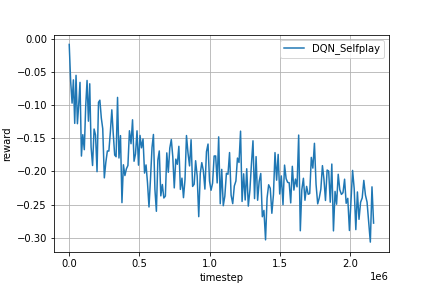

In [ ]:
Image(log_dir + '/self_fig.png')

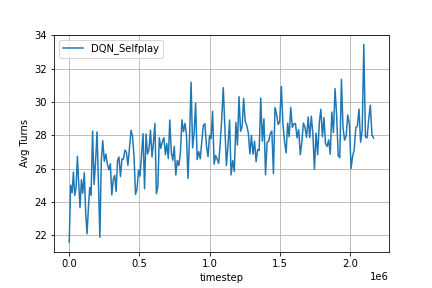

In [ ]:
Image(log_dir + '/self_fig2.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)


Stuck in infinite loop... reset time


{'Avg Turns': 19.07, 'Gin': 1, 'Knock': 2, 'Other': 97}

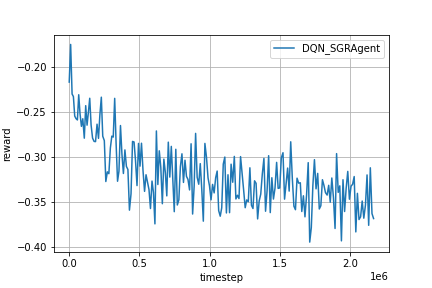

In [ ]:
Image(log_dir + '/sgr_fig.png')

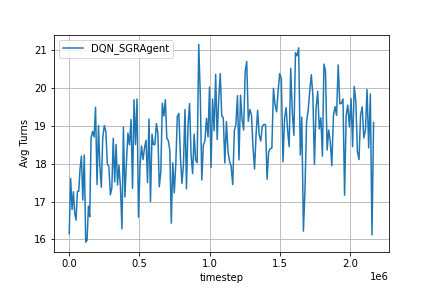

In [ ]:
Image(log_dir + '/sgr_fig2.png')

## TEST31 - BS = 256

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST31'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 256

# Train the agent every X steps
# default: 1
train_every = 100

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
{'Gin': 23, 'Knock': 27, 'Other': 50, 'Avg Turns': 47.75}
----------------------------------------

Selfplay:

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

Stuck in infinite loop... reset time

----------------------------------------
  timestep     |  607954
  reward       |  -0.2299000000000001
  Avg Turns    |  25.31
{'Gin': 2, 'Knock': 14, 'Other': 84, 'Avg Turns': 25.31}
----------------------------------------

SGRAgent:

Stuck in infinite loop... reset time

----------------------------------------
  timestep     |  607954
  reward       |  -0.32439999999999986
  Avg Turns    |  17.9
{'Gin': 1, 'Knock': 6, 'Other': 93, 'Avg Turns': 17.9}
----------------------------------------
INFO - Agent dqn, step 310200, rl-loss: 0.0007856352021917701
Random:

---------------------------------------

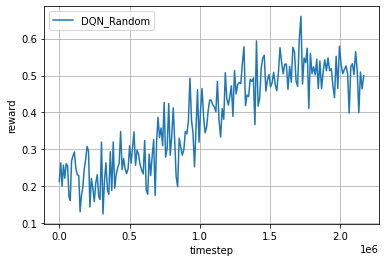

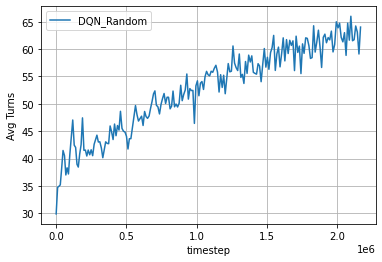

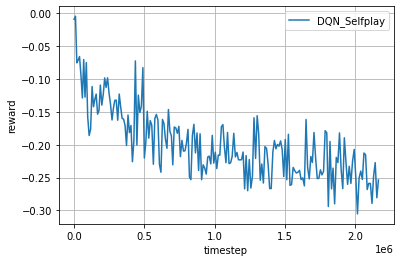

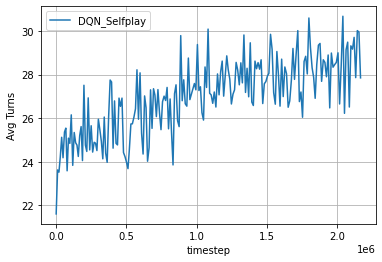

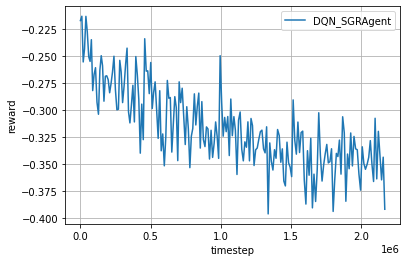

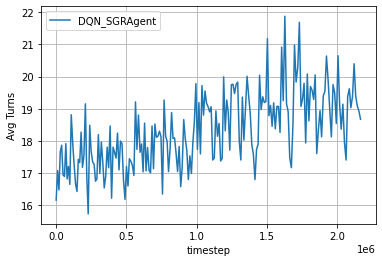

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 64.35, 'Gin': 49, 'Knock': 22, 'Other': 29}

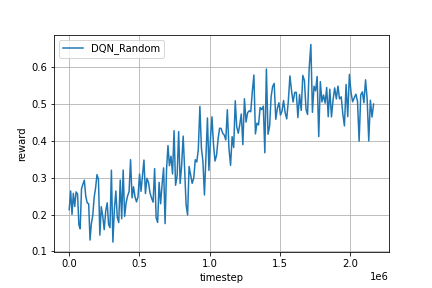

In [ ]:
Image(log_dir + '/rand_fig.png')

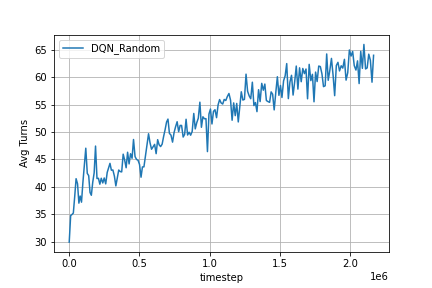

In [ ]:
Image(log_dir + '/rand_fig2.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)


Stuck in infinite loop... reset time

Stuck in infinite loop... reset time


{'Avg Turns': 27.08, 'Gin': 5, 'Knock': 5, 'Other': 90}

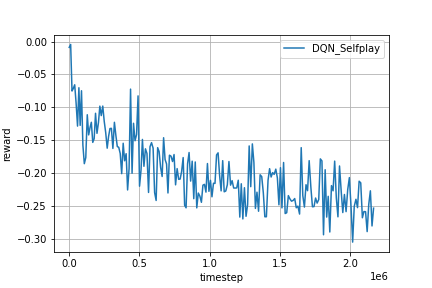

In [ ]:
Image(log_dir + '/self_fig.png')

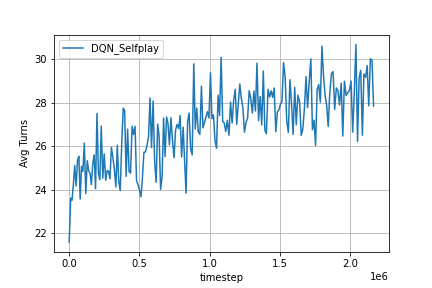

In [ ]:
Image(log_dir + '/self_fig2.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 19.12, 'Gin': 1, 'Knock': 1, 'Other': 98}

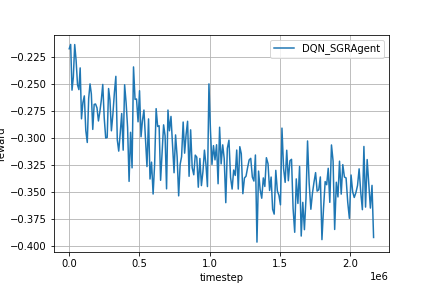

In [ ]:
Image(log_dir + '/sgr_fig.png')

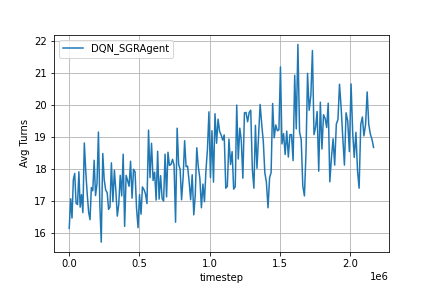

In [ ]:
Image(log_dir + '/sgr_fig2.png')

# train_every

- TEST32: 1
- TEST33: 10
- (100 default)
- TEST34: 1000
- TEST35: 10000
- **TEST36: 100000**


## TEST32 - train_every 1 step

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST32'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 1

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
  Gin: 0 | Knock: 0 | Other: 100
----------------------------------------
INFO - Agent dqn, step 676000, rl-loss: 1.5645009625586681e-06
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 677000, rl-loss: 2.1819643734488636e-05
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 678000, rl-loss: 1.887193684524391e-05
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 679000, rl-loss: 3.506146458676085e-05
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 680000, rl-loss: 3.31190021825023e-05
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 681000, rl-loss: 0.0011909670429304242
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 682000, rl-loss: 2.4923972887336276e-05
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 682899, rl-loss: 7.66973062127363e-06

---------------------------

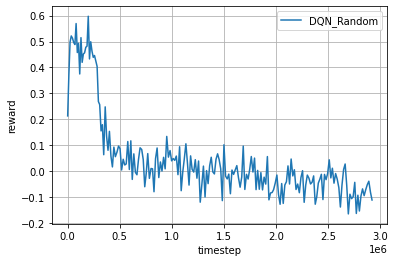

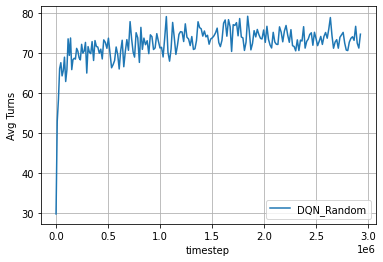

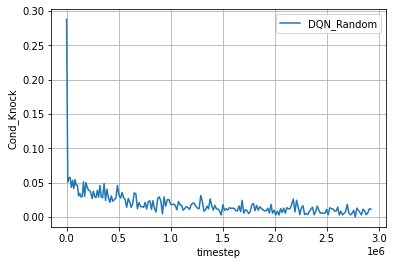

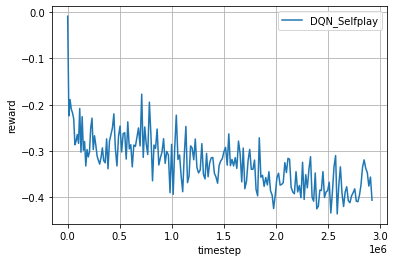

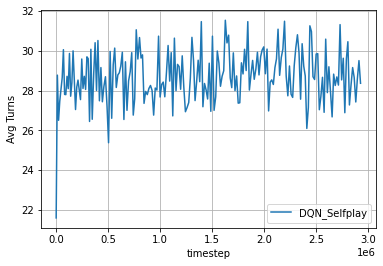

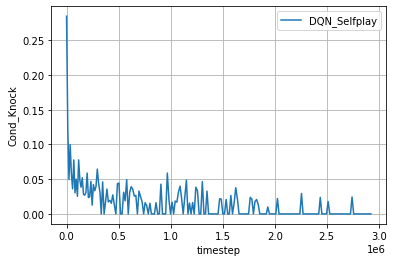

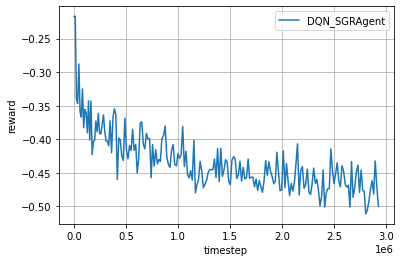

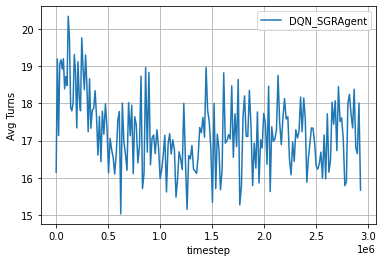

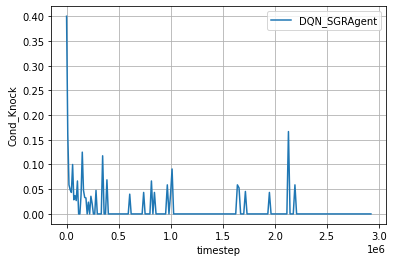

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 72.11, 'Gin': 10, 'Knock': 1, 'Knock_Possible': 366, 'Other': 89}

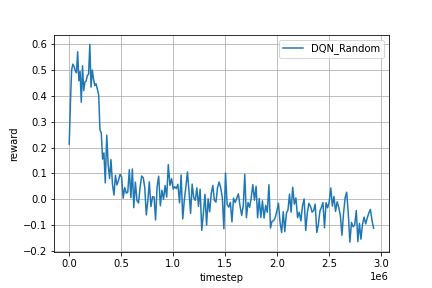

In [ ]:
Image(log_dir + '/rand_fig.png')

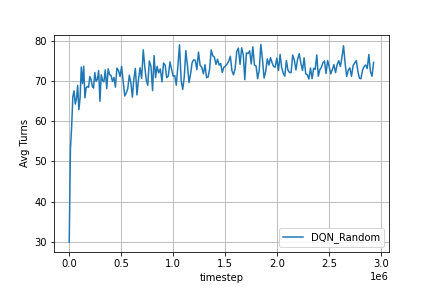

In [ ]:
Image(log_dir + '/rand_fig2.png')

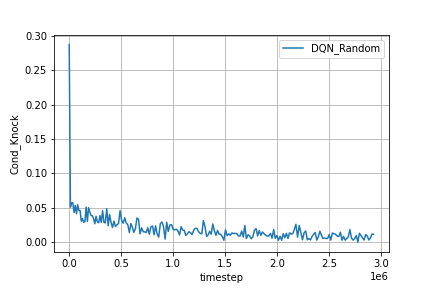

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 30.14, 'Gin': 2, 'Knock': 0, 'Knock_Possible': 40, 'Other': 98}

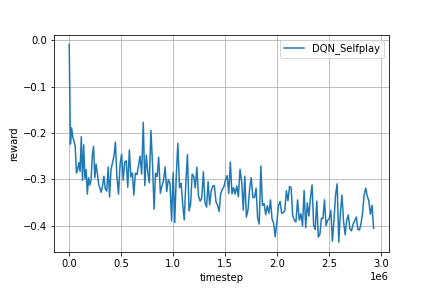

In [ ]:
Image(log_dir + '/self_fig.png')

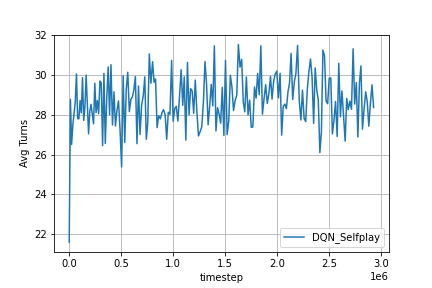

In [ ]:
Image(log_dir + '/self_fig2.png')

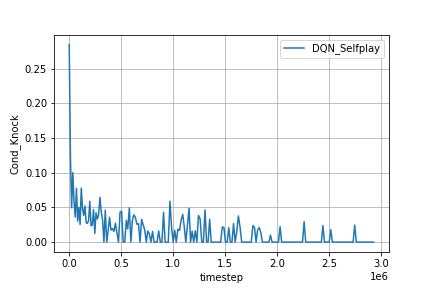

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 17.22, 'Gin': 0, 'Knock': 0, 'Knock_Possible': 14, 'Other': 100}

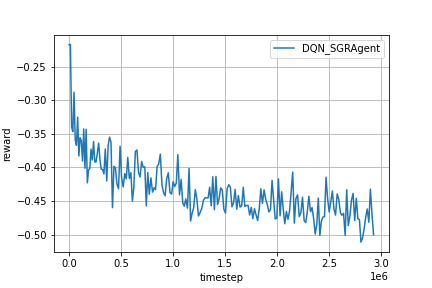

In [ ]:
Image(log_dir + '/sgr_fig.png')

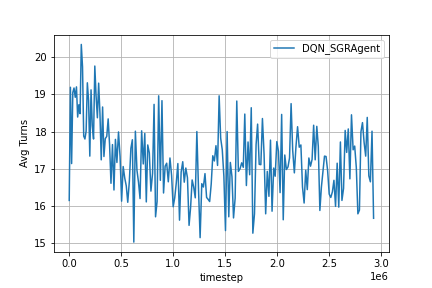

In [ ]:
Image(log_dir + '/sgr_fig2.png')

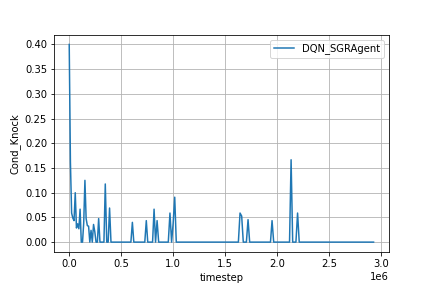

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST33 - train_every 10 steps

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST33'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 10

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
----------------------------------------
INFO - Agent dqn, step 307220, rl-loss: 0.007178596220910549

----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  613435
  reward       |  0.5095000000000003
  Avg Turns    |  67.59
  Cond_Knock   |  0.043478260869565216
  Gin: 43 | Knock: 31 | Other: 26
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  613435
  reward       |  -0.24820000000000003
  Avg Turns    |  30.25
  Cond_Knock   |  0.061855670103092786
  Gin: 5 | Knock: 6 | Other: 89
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  613435
  reward       |  -0.3664
  Avg Turns    |  18.9
  Cond_Knock   |  0.09090909090909091
  Gin: 0 | Knock: 3 | Other: 97
----------------------------------------
INFO - Agent dqn, step 311000, rl

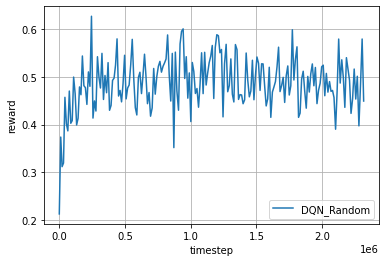

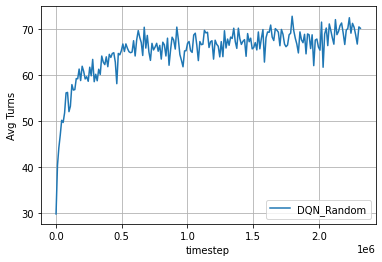

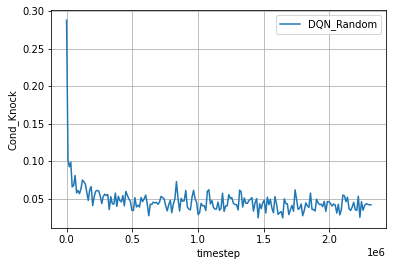

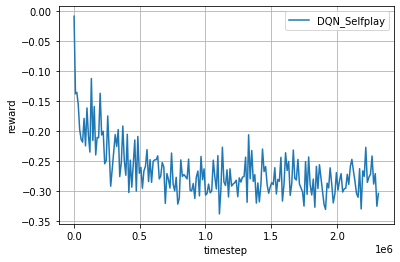

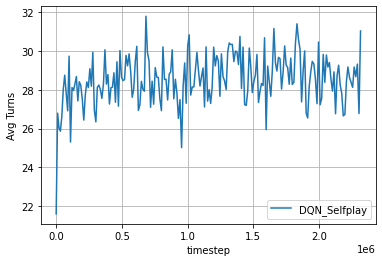

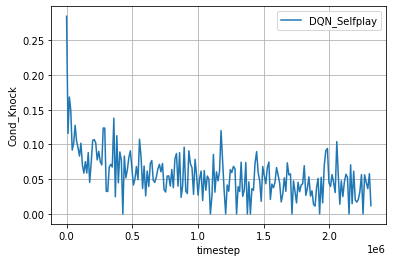

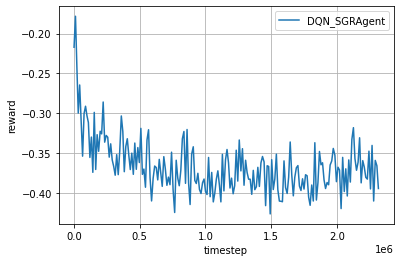

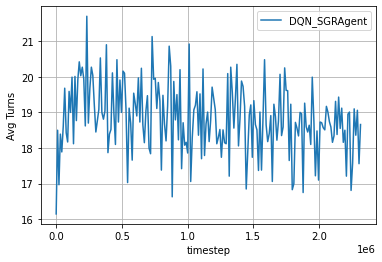

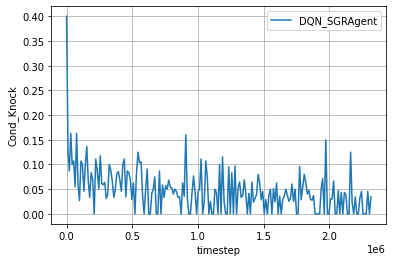

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 69.53,
 'Gin': 43,
 'Knock': 24,
 'Knock_Possible': 634,
 'Other': 33}

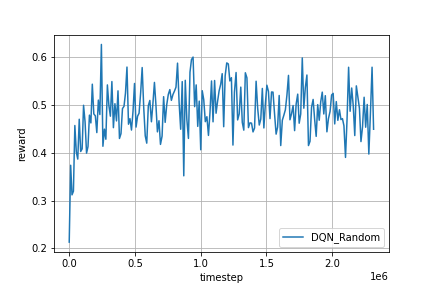

In [ ]:
Image(log_dir + '/rand_fig.png')

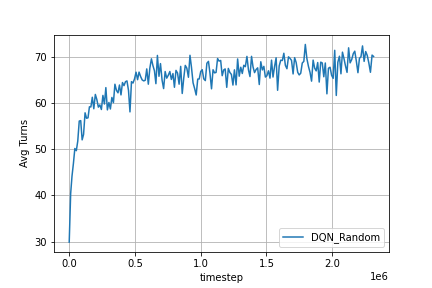

In [ ]:
Image(log_dir + '/rand_fig2.png')

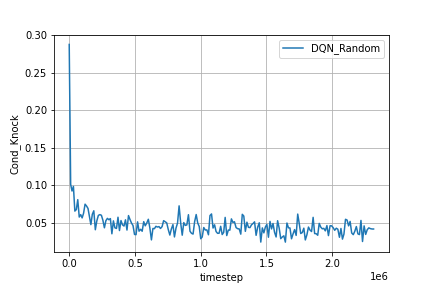

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 29.51, 'Gin': 3, 'Knock': 1, 'Knock_Possible': 75, 'Other': 96}

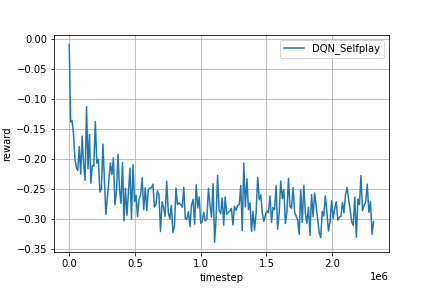

In [ ]:
Image(log_dir + '/self_fig.png')

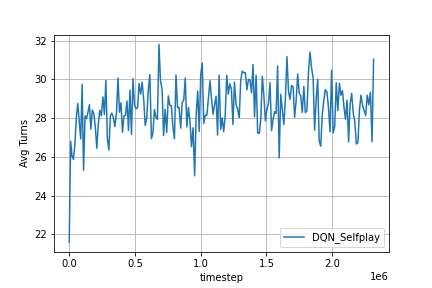

In [ ]:
Image(log_dir + '/self_fig2.png')

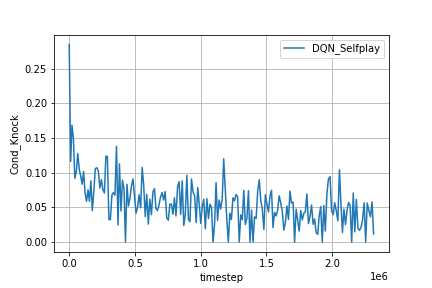

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 17.37, 'Gin': 0, 'Knock': 0, 'Knock_Possible': 25, 'Other': 100}

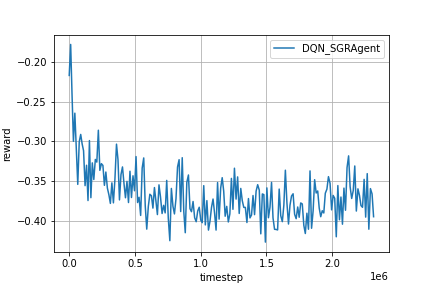

In [ ]:
Image(log_dir + '/sgr_fig.png')

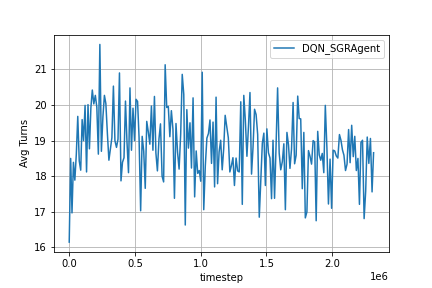

In [ ]:
Image(log_dir + '/sgr_fig2.png')

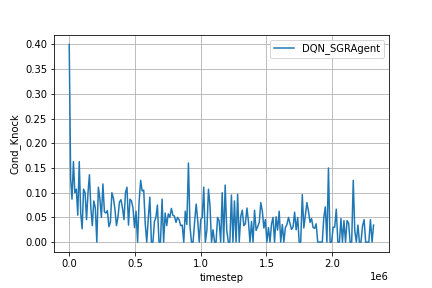

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST34 - train_every 1000 steps

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST34'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 1000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
  timestep     |  454618
  reward       |  -0.3007000000000002
  Avg Turns    |  18.16
  Cond_Knock   |  0.08333333333333333
  Gin: 3 | Knock: 6 | Other: 91
----------------------------------------
INFO - Agent dqn, step 233000, rl-loss: 1.2581310329551343e-05

----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  465010
  reward       |  0.392
  Avg Turns    |  41.15
  Cond_Knock   |  0.13449023861171366
  Gin: 25 | Knock: 62 | Other: 13
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  465010
  reward       |  -0.107
  Avg Turns    |  24.55
  Cond_Knock   |  0.24
  Gin: 6 | Knock: 24 | Other: 70
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  465010
  reward       |  -0.20470000000000005
  Avg Turns    |  19.58
  Cond_Knock  

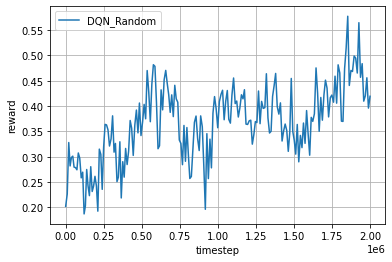

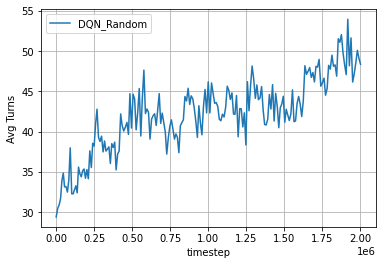

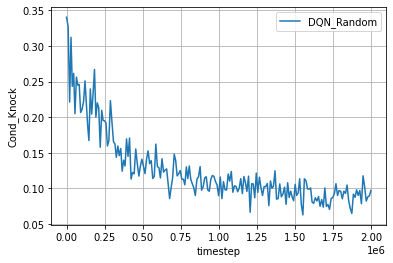

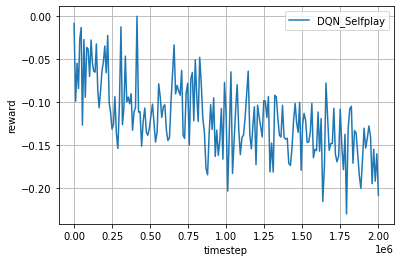

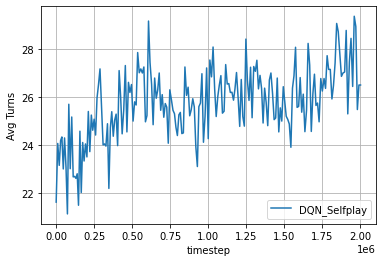

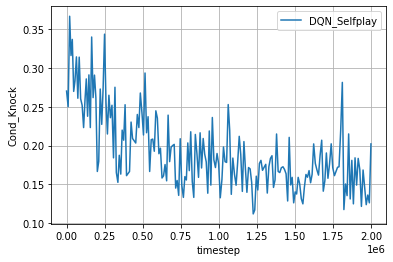

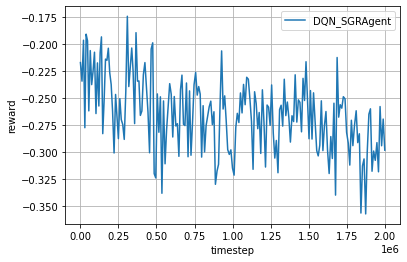

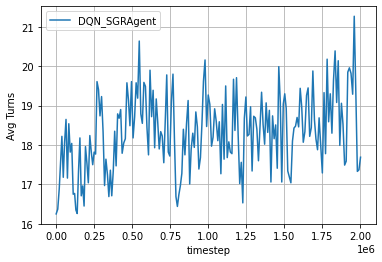

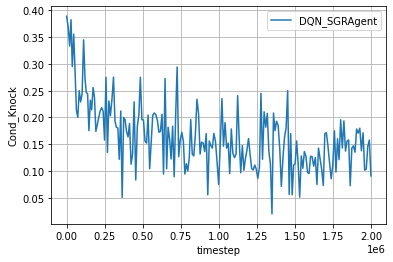

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 48.76,
 'Gin': 32,
 'Knock': 48,
 'Knock_Possible': 560,
 'Other': 20}

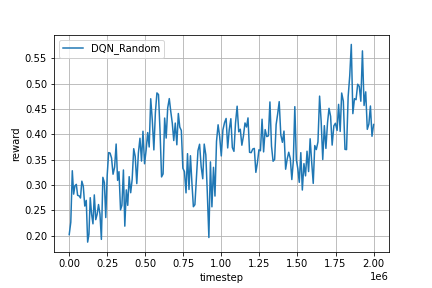

In [ ]:
Image(log_dir + '/rand_fig.png')

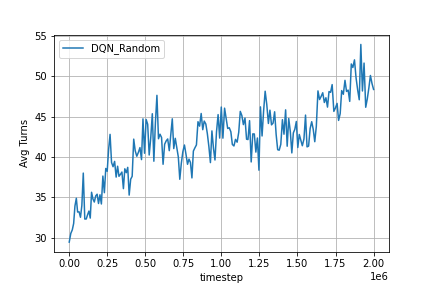

In [ ]:
Image(log_dir + '/rand_fig2.png')

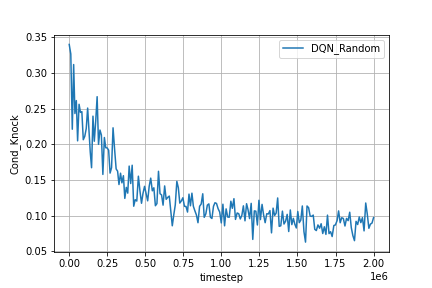

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 26.41, 'Gin': 4, 'Knock': 7, 'Knock_Possible': 101, 'Other': 89}

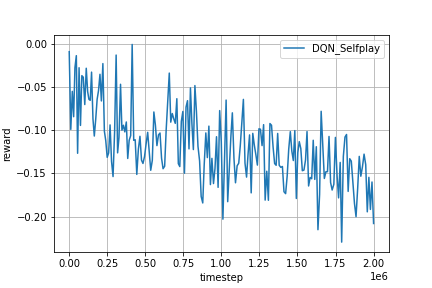

In [ ]:
Image(log_dir + '/self_fig.png')

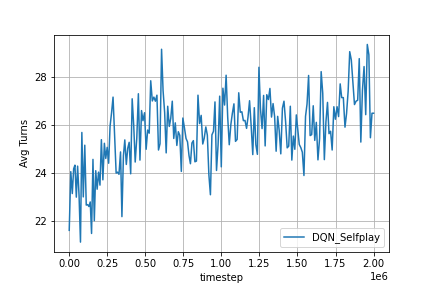

In [ ]:
Image(log_dir + '/self_fig2.png')

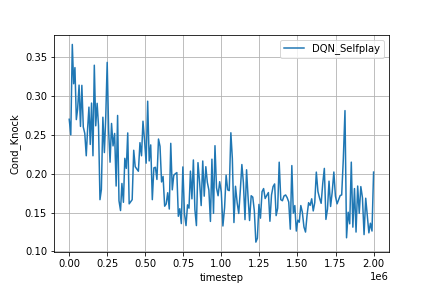

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 18.78, 'Gin': 1, 'Knock': 6, 'Knock_Possible': 50, 'Other': 93}

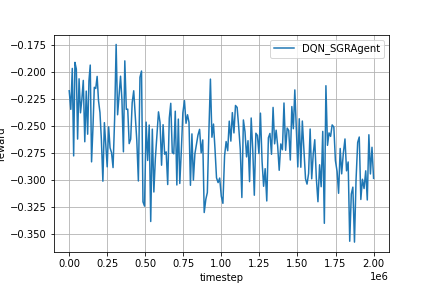

In [ ]:
Image(log_dir + '/sgr_fig.png')

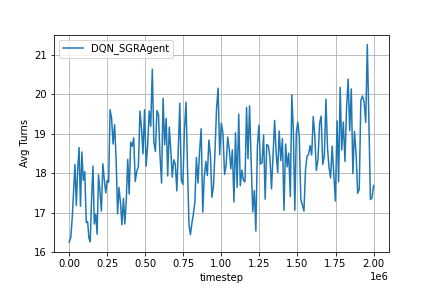

In [ ]:
Image(log_dir + '/sgr_fig2.png')

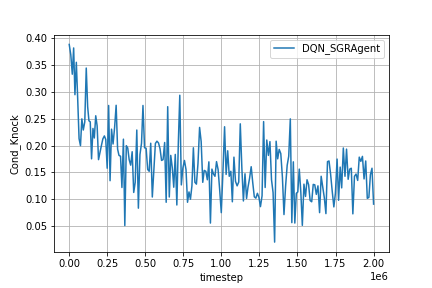

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST35 - train_every 10000 steps

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST35'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  407942
  reward       |  -0.24810000000000007
  Avg Turns    |  17.68
  Cond_Knock   |  0.23404255319148937
  Gin: 2 | Knock: 11 | Other: 87
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  416546
  reward       |  0.22019999999999967
  Avg Turns    |  33.63
  Cond_Knock   |  0.24050632911392406
  Gin: 14 | Knock: 76 | Other: 10
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  416546
  reward       |  -0.009900000000000006
  Avg Turns    |  21.95
  Cond_Knock   |  0.2894736842105263
  Gin: 4 | Knock: 33 | Other: 63
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  416546
  reward       |  -0.23070000000000007
  Avg Turns  

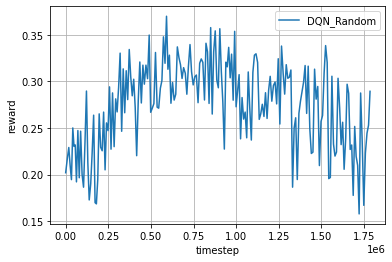

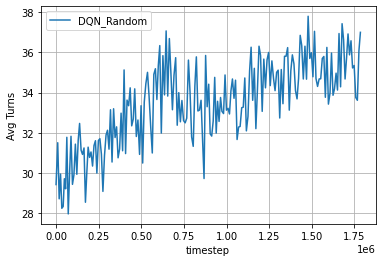

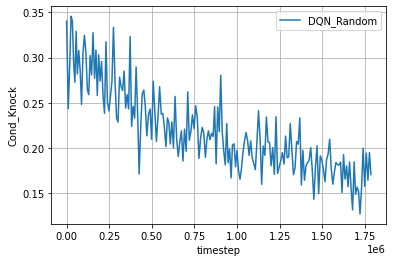

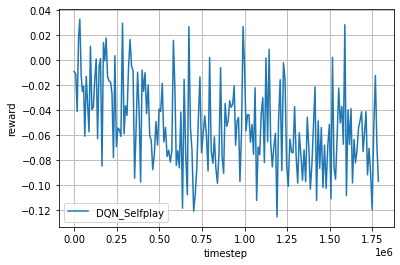

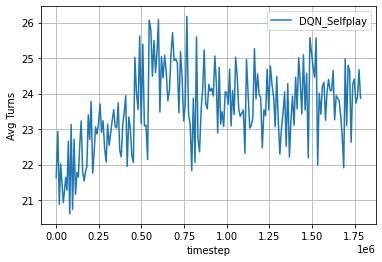

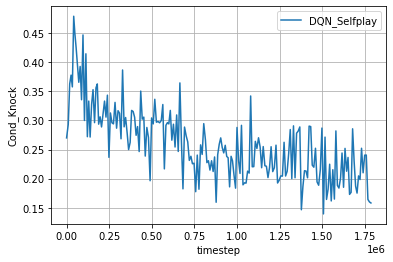

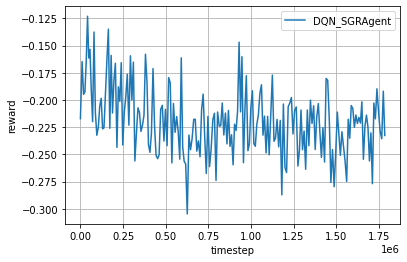

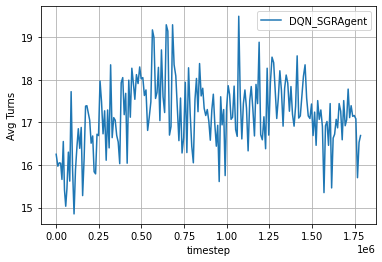

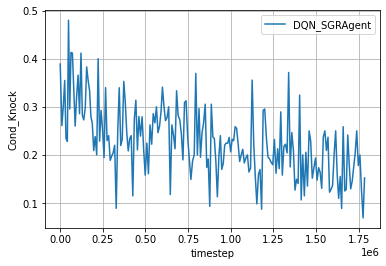

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 34.91,
 'Gin': 12,
 'Knock': 68,
 'Knock_Possible': 339,
 'Other': 20}

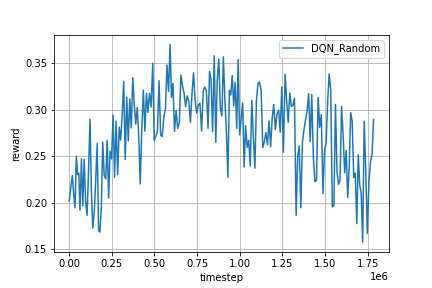

In [ ]:
Image(log_dir + '/rand_fig.png')

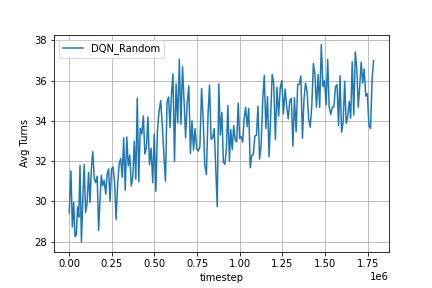

In [ ]:
Image(log_dir + '/rand_fig2.png')

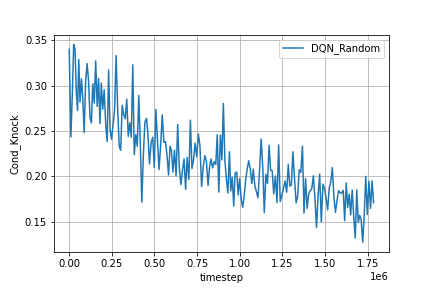

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 23.99, 'Gin': 5, 'Knock': 26, 'Knock_Possible': 124, 'Other': 69}

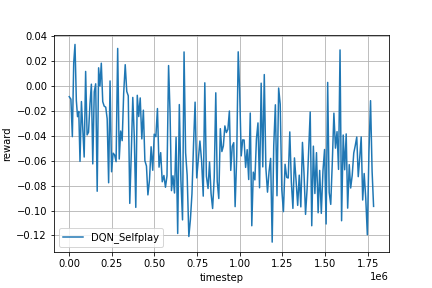

In [ ]:
Image(log_dir + '/self_fig.png')

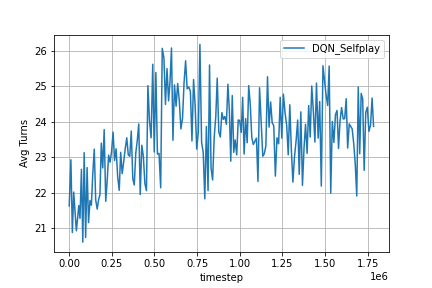

In [ ]:
Image(log_dir + '/self_fig2.png')

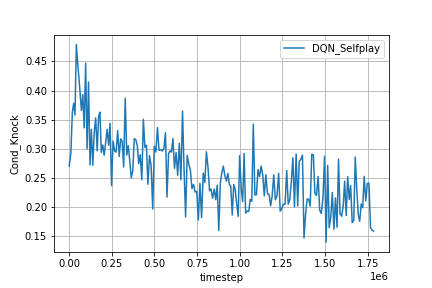

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 16.87, 'Gin': 1, 'Knock': 6, 'Knock_Possible': 51, 'Other': 93}

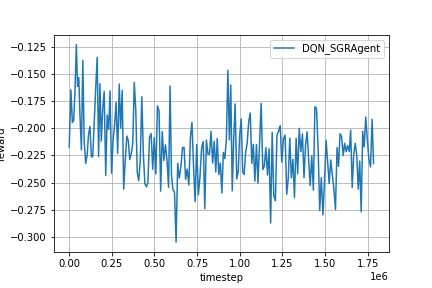

In [ ]:
Image(log_dir + '/sgr_fig.png')

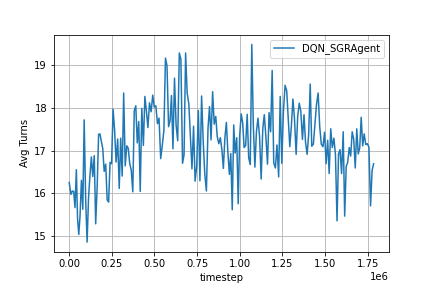

In [ ]:
Image(log_dir + '/sgr_fig2.png')

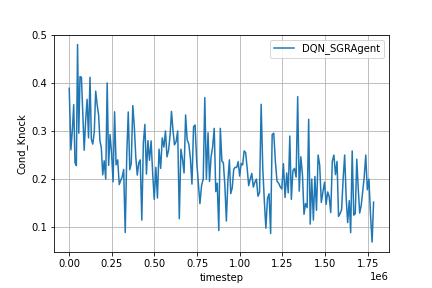

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST36 - train_every 100000 steps

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST36'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 100000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  345219
  reward       |  -0.15019999999999997
  Avg Turns    |  15.4
  Cond_Knock   |  0.23529411764705882
  Gin: 1 | Knock: 12 | Other: 87
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  352901
  reward       |  0.2500999999999997
  Avg Turns    |  27.63
  Cond_Knock   |  0.3674418604651163
  Gin: 7 | Knock: 79 | Other: 14
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  352901
  reward       |  0.045100000000000015
  Avg Turns    |  21.27
  Cond_Knock   |  0.3493150684931507
  Gin: 6 | Knock: 51 | Other: 43
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  352901
  reward       |  -0.14739999999999998
  Avg Turns    |  

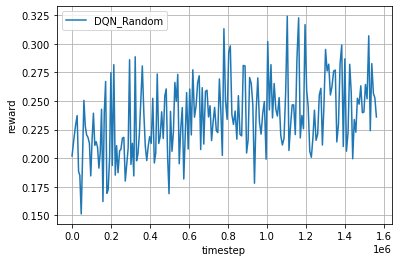

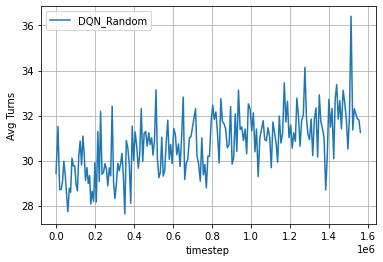

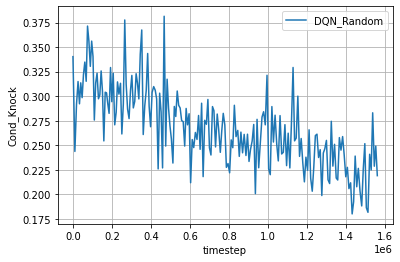

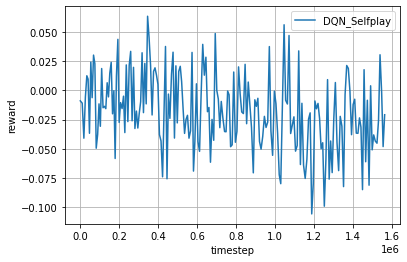

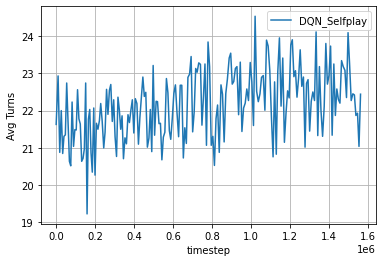

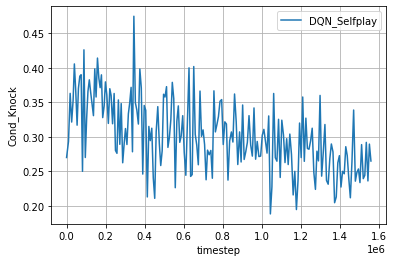

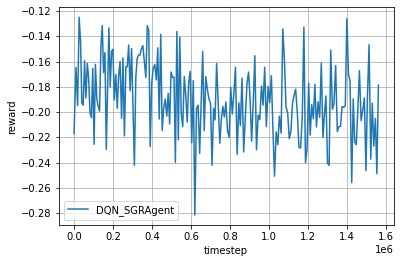

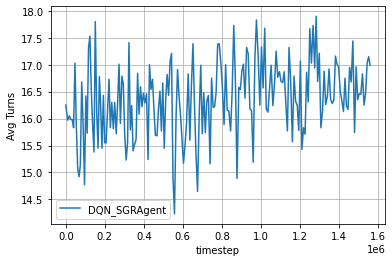

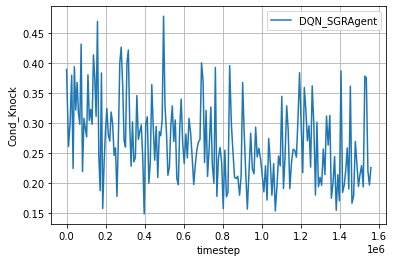

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 31.69,
 'Gin': 14,
 'Knock': 68,
 'Knock_Possible': 364,
 'Other': 18}

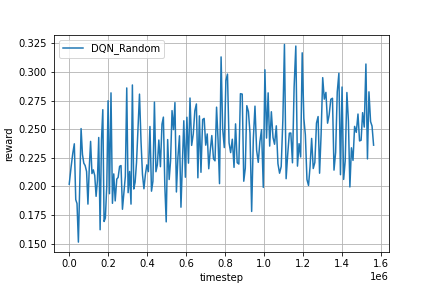

In [ ]:
Image(log_dir + '/rand_fig.png')

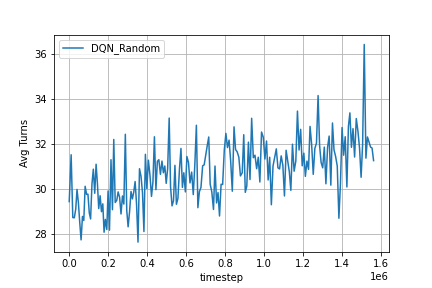

In [ ]:
Image(log_dir + '/rand_fig2.png')

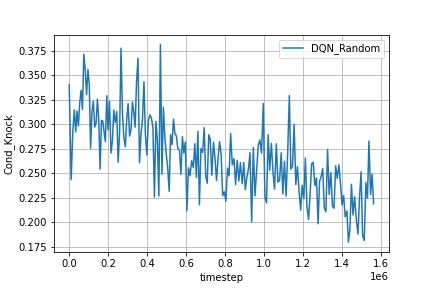

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 21.4, 'Gin': 8, 'Knock': 36, 'Knock_Possible': 183, 'Other': 56}

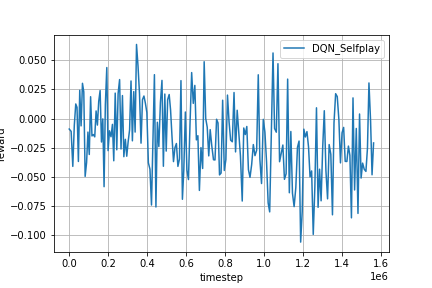

In [ ]:
Image(log_dir + '/self_fig.png')

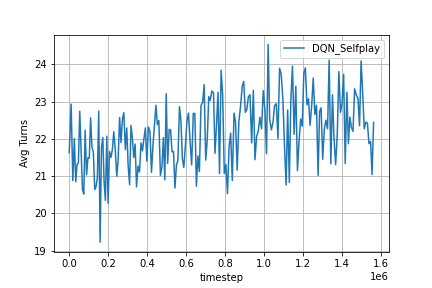

In [ ]:
Image(log_dir + '/self_fig2.png')

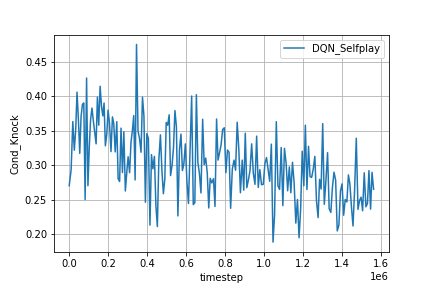

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 15.91, 'Gin': 0, 'Knock': 11, 'Knock_Possible': 49, 'Other': 89}

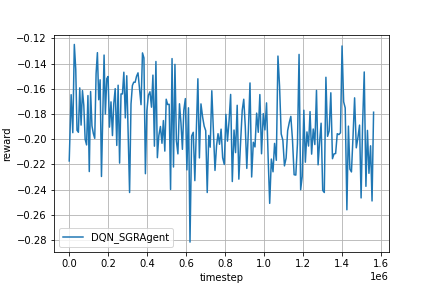

In [ ]:
Image(log_dir + '/sgr_fig.png')

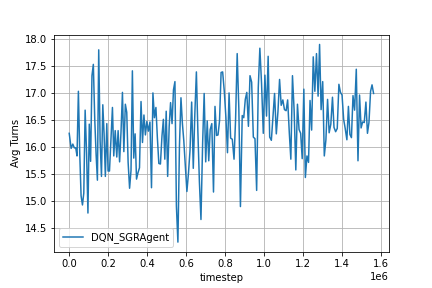

In [ ]:
Image(log_dir + '/sgr_fig2.png')

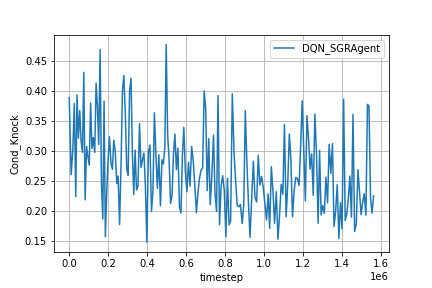

In [ ]:
Image(log_dir + '/sgr_fig3.png')

# replay_memory_init_size

- TEST37: 100
- (1000 default)
- TEST38: 10000
- TEST39: 100000

all equally same


## TEST37 - replay_memory_init_size = 100

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST37'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 100

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  396896
  reward       |  -0.23400000000000007
  Avg Turns    |  16.59
  Cond_Knock   |  0.24242424242424243
  Gin: 3 | Knock: 16 | Other: 81
----------------------------------------
INFO - Agent dqn, step 200100, rl-loss: 0.0041508181020617485

----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  405024
  reward       |  0.23959999999999962
  Avg Turns    |  29.36
  Cond_Knock   |  0.26865671641791045
  Gin: 15 | Knock: 72 | Other: 13
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  405024
  reward       |  0.01620000000000003
  Avg Turns    |  24.68
  Cond_Knock   |  0.2857142857142857
  Gin: 1 | Knock: 44 | Other: 55
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  

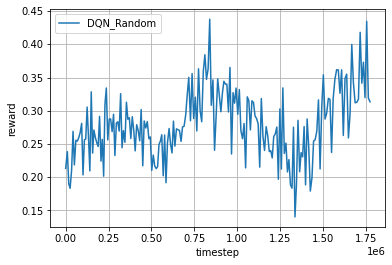

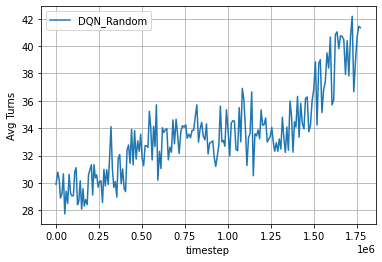

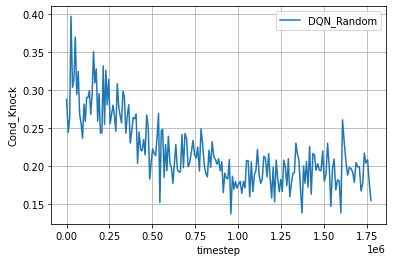

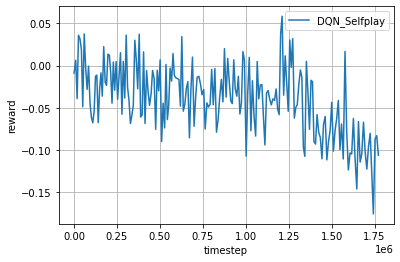

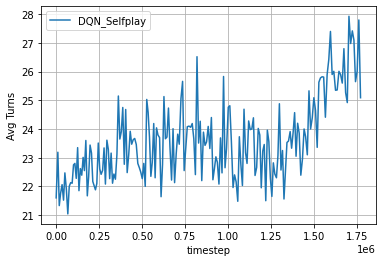

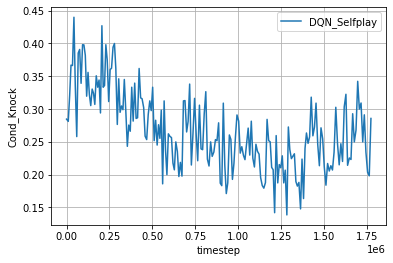

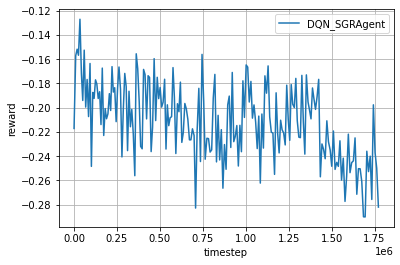

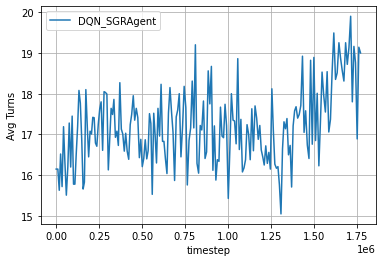

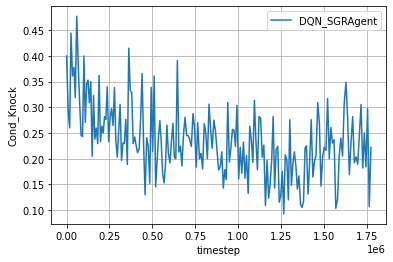

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 40.07, 'Gin': 21, 'Knock': 73, 'Knock_Possible': 416, 'Other': 6}

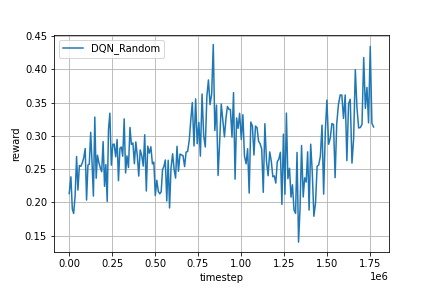

In [ ]:
Image(log_dir + '/rand_fig.png')

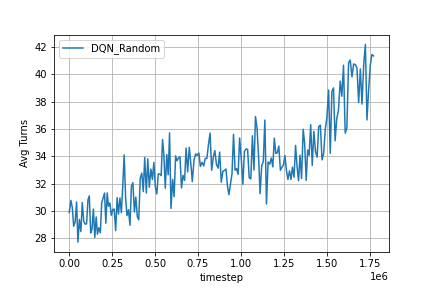

In [ ]:
Image(log_dir + '/rand_fig2.png')

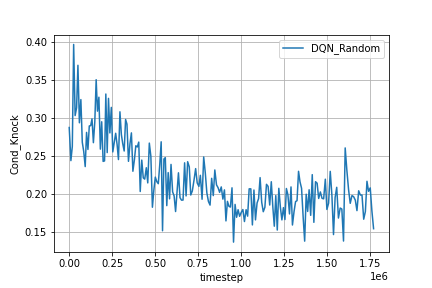

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 28.47, 'Gin': 7, 'Knock': 27, 'Knock_Possible': 129, 'Other': 66}

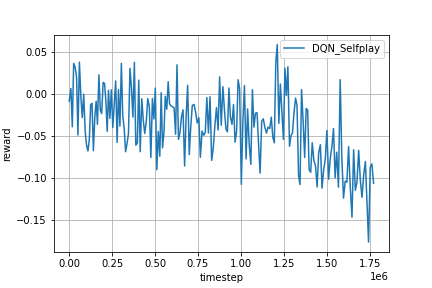

In [ ]:
Image(log_dir + '/self_fig.png')

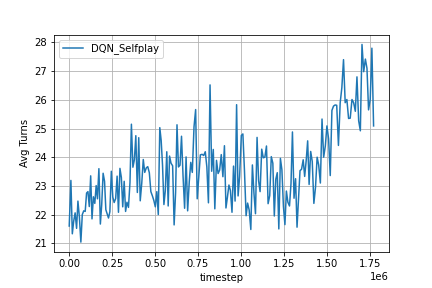

In [ ]:
Image(log_dir + '/self_fig2.png')

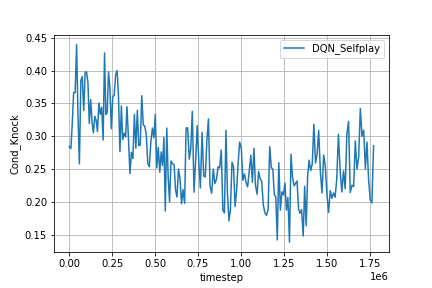

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 18.38, 'Gin': 1, 'Knock': 8, 'Knock_Possible': 29, 'Other': 91}

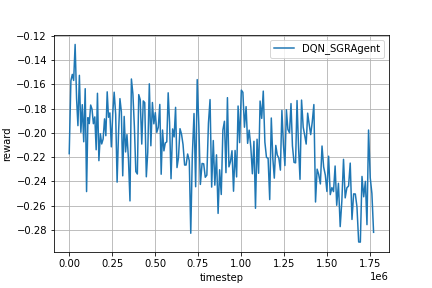

In [ ]:
Image(log_dir + '/sgr_fig.png')

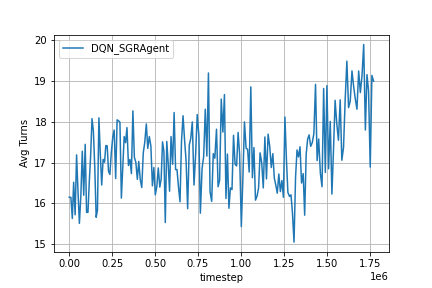

In [ ]:
Image(log_dir + '/sgr_fig2.png')

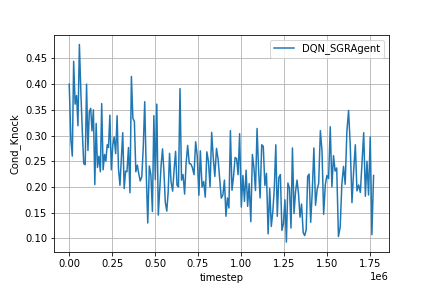

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST38 - replay_memory_init_size = 10000

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST38'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 10000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  417870
  reward       |  -0.23050000000000007
  Avg Turns    |  15.75
  Cond_Knock   |  0.2037037037037037
  Gin: 4 | Knock: 11 | Other: 85
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  426918
  reward       |  0.18759999999999974
  Avg Turns    |  31.89
  Cond_Knock   |  0.25475285171102663
  Gin: 11 | Knock: 67 | Other: 22
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  426918
  reward       |  -0.008600000000000014
  Avg Turns    |  23.01
  Cond_Knock   |  0.25517241379310346
  Gin: 6 | Knock: 37 | Other: 57
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  426918
  reward       |  -0.20910000000000004
  Avg Turns  

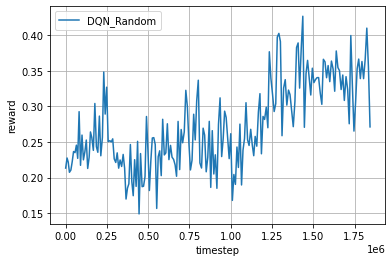

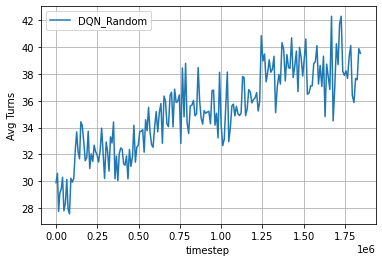

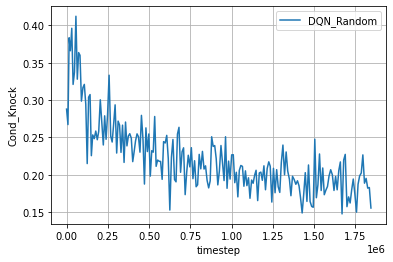

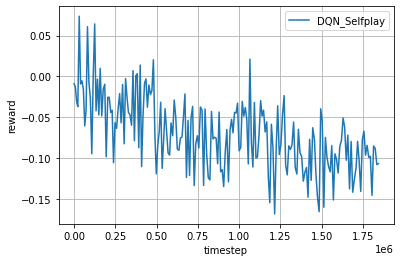

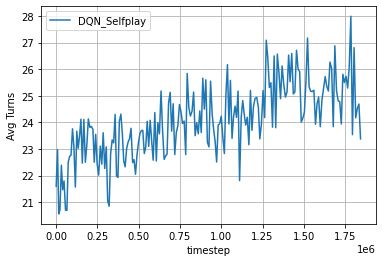

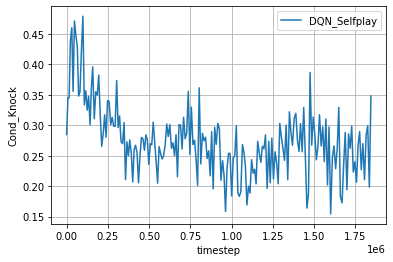

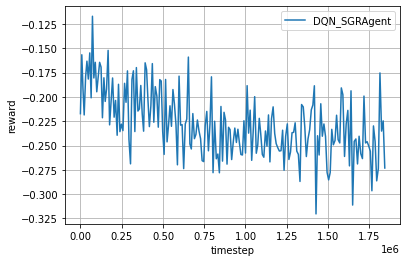

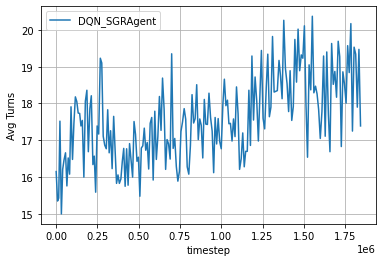

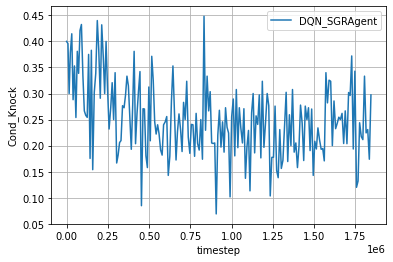

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 28.34, 'Gin': 9, 'Knock': 75, 'Knock_Possible': 204, 'Other': 16}

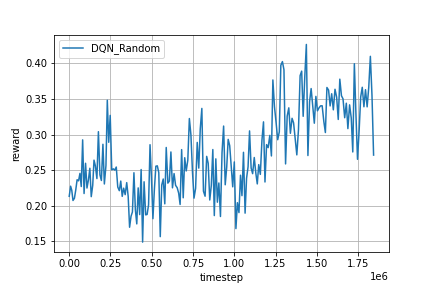

In [ ]:
Image(log_dir + '/rand_fig.png')

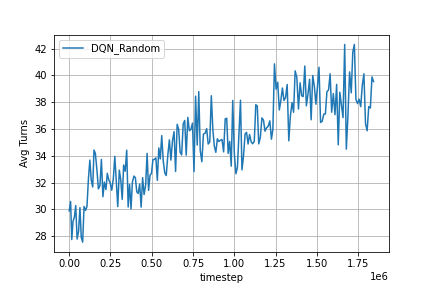

In [ ]:
Image(log_dir + '/rand_fig2.png')

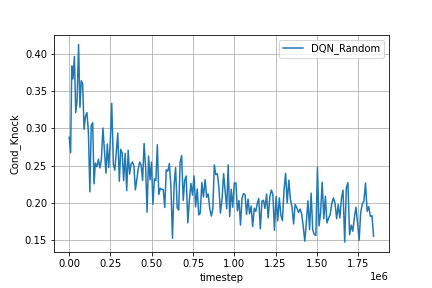

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 21.42, 'Gin': 4, 'Knock': 41, 'Knock_Possible': 105, 'Other': 55}

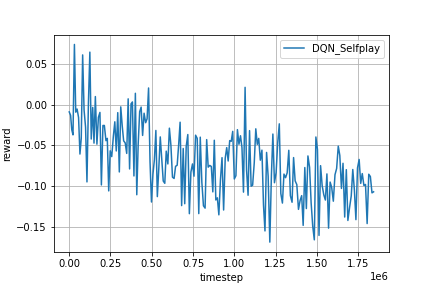

In [ ]:
Image(log_dir + '/self_fig.png')

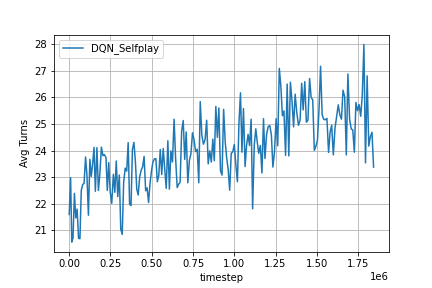

In [ ]:
Image(log_dir + '/self_fig2.png')

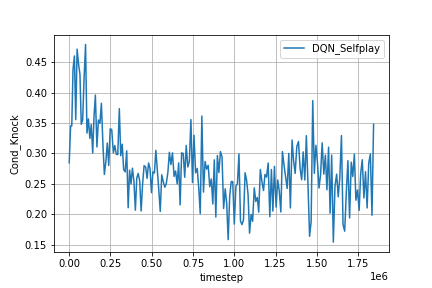

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 14.8, 'Gin': 1, 'Knock': 16, 'Knock_Possible': 31, 'Other': 83}

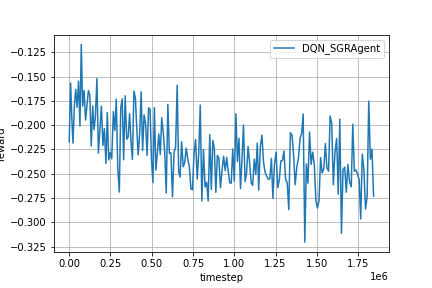

In [ ]:
Image(log_dir + '/sgr_fig.png')

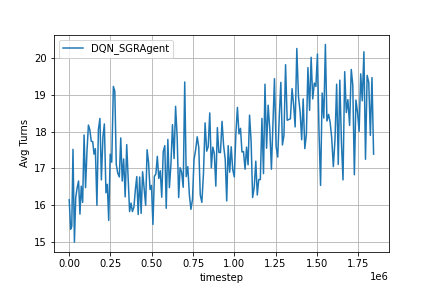

In [ ]:
Image(log_dir + '/sgr_fig2.png')

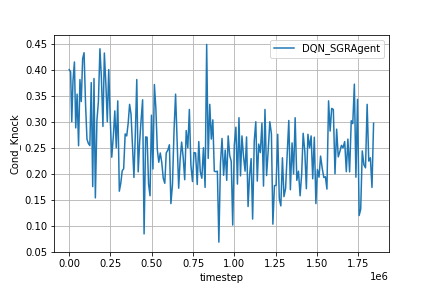

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST39 - replay_memory_init_size = 100000

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST39'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# The initial memory size
# default: 100
memory_init_size = 100000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=20000,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=20000,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  311702
  reward       |  -0.1884
  Avg Turns    |  15.86
  Cond_Knock   |  0.22950819672131148
  Gin: 1 | Knock: 14 | Other: 85
----------------------------------------
INFO - Agent dqn, step 160000, rl-loss: 3.278769872849807e-05

----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  319632
  reward       |  0.2475999999999997
  Avg Turns    |  31.39
  Cond_Knock   |  0.2459016393442623
  Gin: 8 | Knock: 75 | Other: 17
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  319632
  reward       |  0.024100000000000014
  Avg Turns    |  21.88
  Cond_Knock   |  0.3203125
  Gin: 6 | Knock: 41 | Other: 53
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  319632
  reward       | 

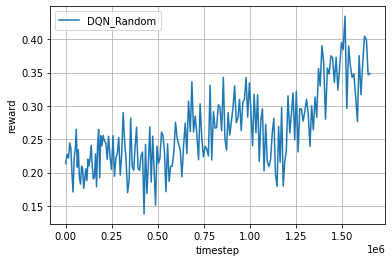

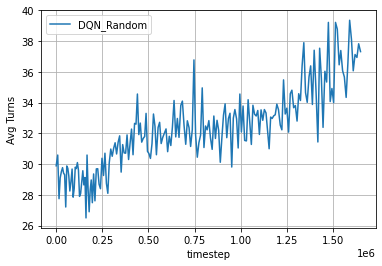

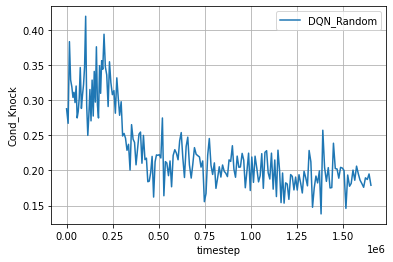

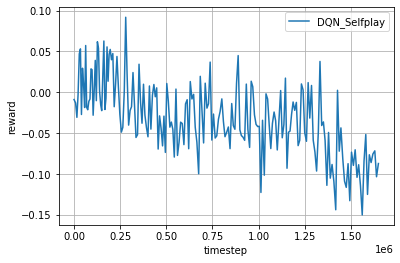

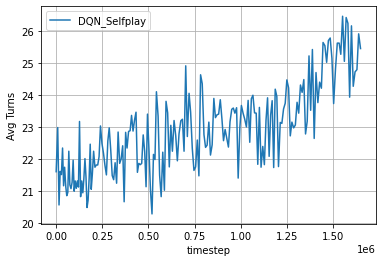

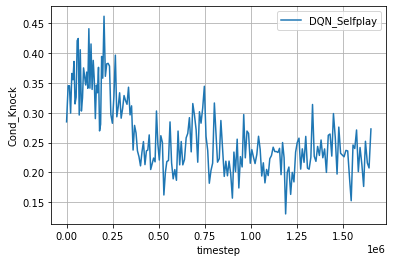

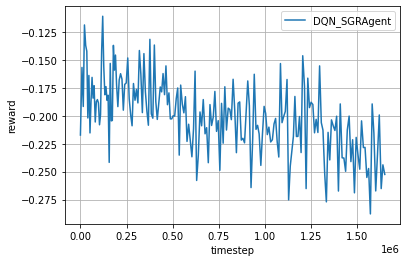

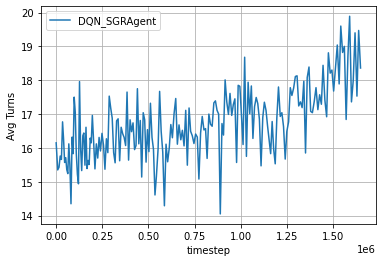

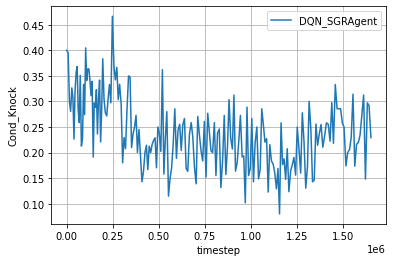

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 36.49, 'Gin': 27, 'Knock': 70, 'Knock_Possible': 348, 'Other': 3}

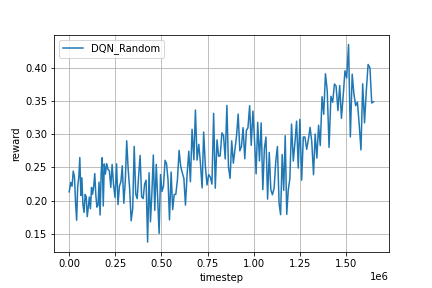

In [ ]:
Image(log_dir + '/rand_fig.png')

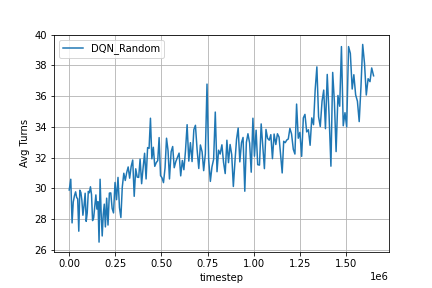

In [ ]:
Image(log_dir + '/rand_fig2.png')

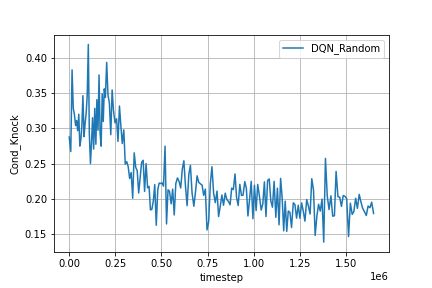

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 23.82, 'Gin': 3, 'Knock': 28, 'Knock_Possible': 106, 'Other': 69}

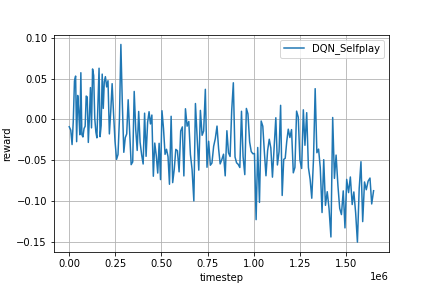

In [ ]:
Image(log_dir + '/self_fig.png')

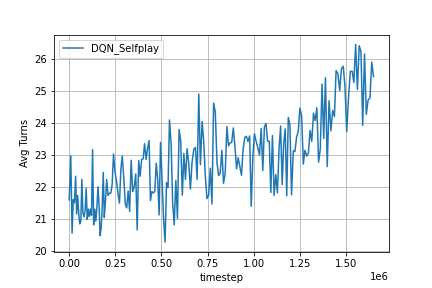

In [ ]:
Image(log_dir + '/self_fig2.png')

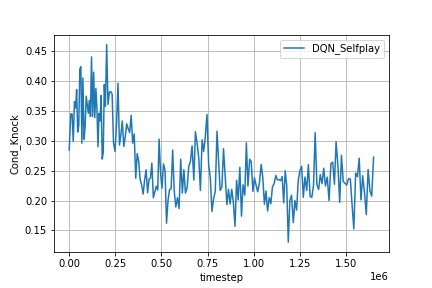

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 17.48, 'Gin': 0, 'Knock': 6, 'Knock_Possible': 40, 'Other': 94}

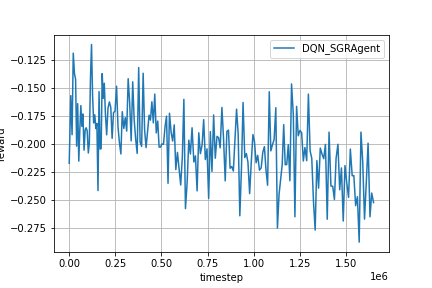

In [ ]:
Image(log_dir + '/sgr_fig.png')

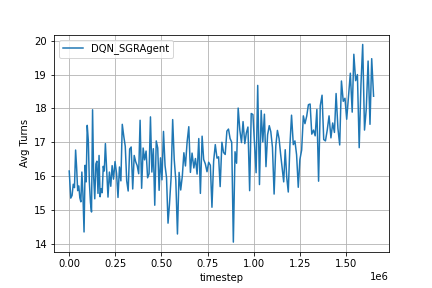

In [ ]:
Image(log_dir + '/sgr_fig2.png')

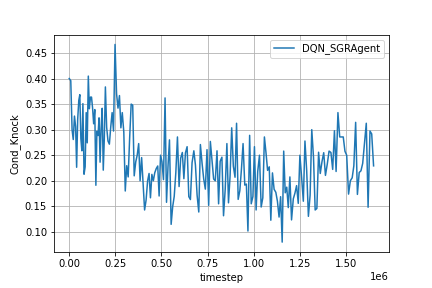

In [ ]:
Image(log_dir + '/sgr_fig3.png')

# replay_memory_size
- TEST40: 200
- TEST41: 2000
- (20000 default)
- TEST42: 200000

## TEST40 - replay_memory_size = 200

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST40'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 200


# The initial memory size
# default: 100
memory_init_size = 100000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 100000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  304161
  reward       |  -0.21870000000000012
  Avg Turns    |  15.82
  Cond_Knock   |  0.3191489361702128
  Gin: 2 | Knock: 15 | Other: 83
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  311746
  reward       |  0.2639999999999996
  Avg Turns    |  28.73
  Cond_Knock   |  0.3389121338912134
  Gin: 5 | Knock: 81 | Other: 14
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  311746
  reward       |  0.06350000000000003
  Avg Turns    |  21.06
  Cond_Knock   |  0.3472222222222222
  Gin: 4 | Knock: 50 | Other: 46
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  311746
  reward       |  -0.11320000000000008
  Avg Turns    |  1

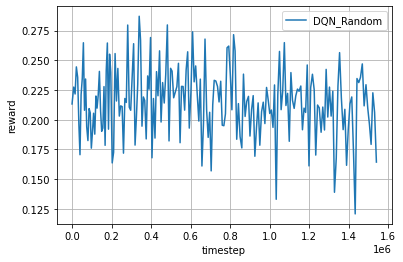

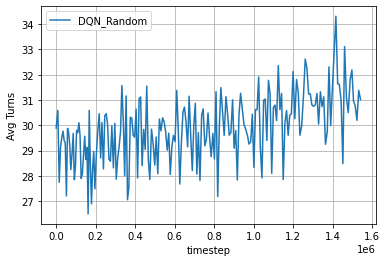

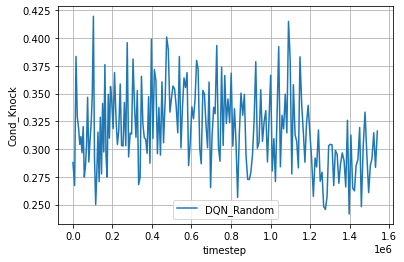

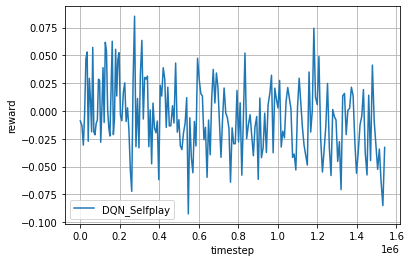

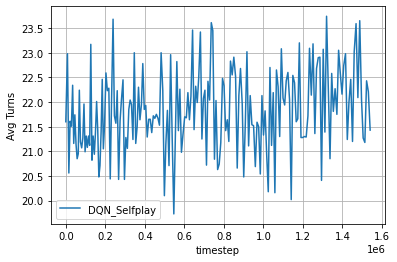

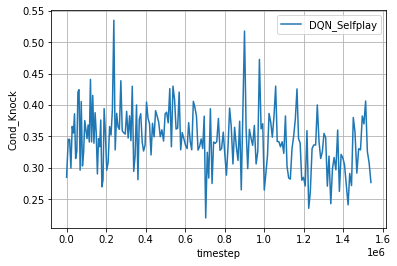

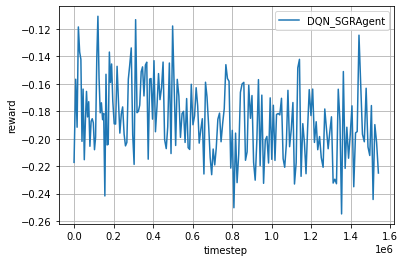

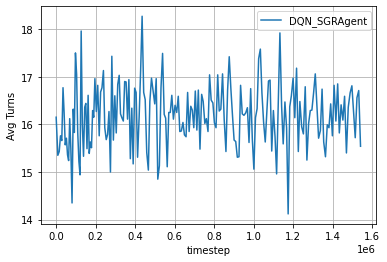

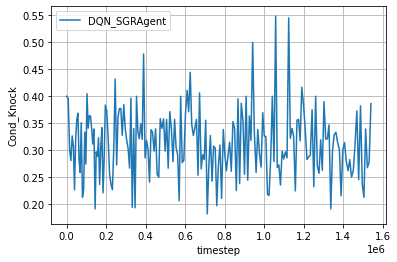

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 30.05,
 'Gin': 10,
 'Knock': 70,
 'Knock_Possible': 266,
 'Other': 20}

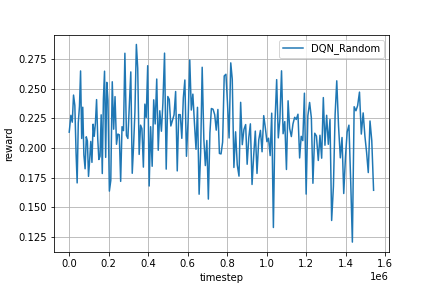

In [ ]:
Image(log_dir + '/rand_fig.png')

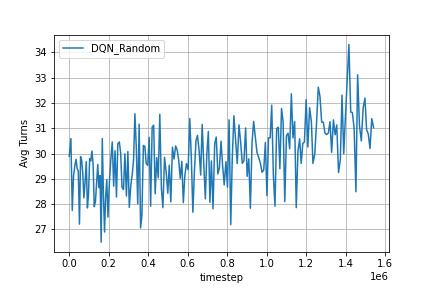

In [ ]:
Image(log_dir + '/rand_fig2.png')

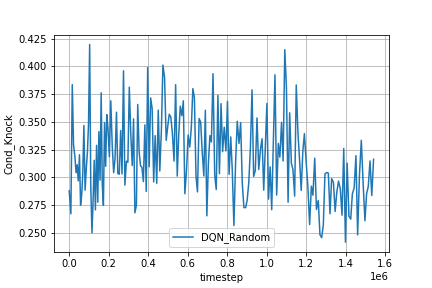

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 22.34, 'Gin': 2, 'Knock': 37, 'Knock_Possible': 150, 'Other': 61}

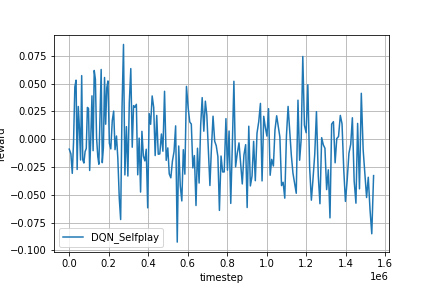

In [ ]:
Image(log_dir + '/self_fig.png')

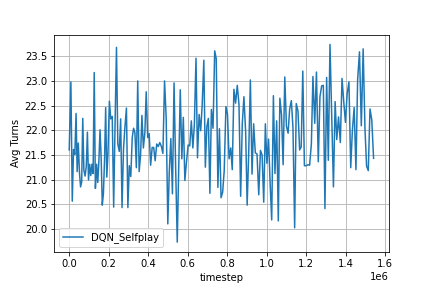

In [ ]:
Image(log_dir + '/self_fig2.png')

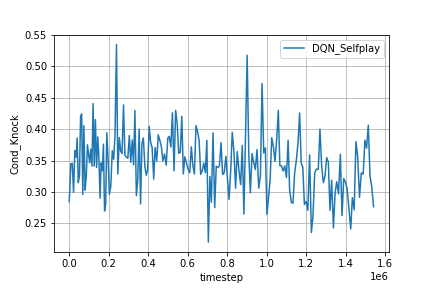

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 15.8, 'Gin': 0, 'Knock': 14, 'Knock_Possible': 57, 'Other': 86}

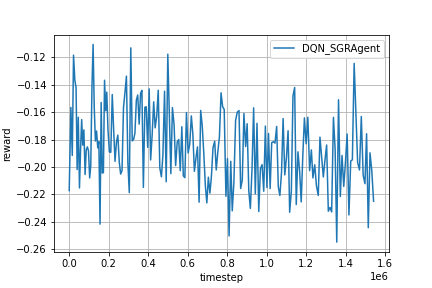

In [ ]:
Image(log_dir + '/sgr_fig.png')

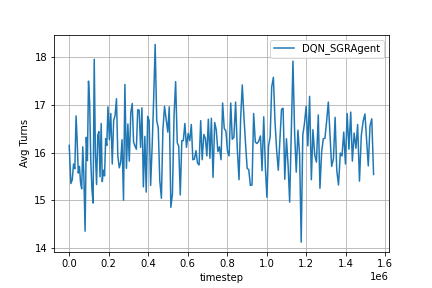

In [ ]:
Image(log_dir + '/sgr_fig2.png')

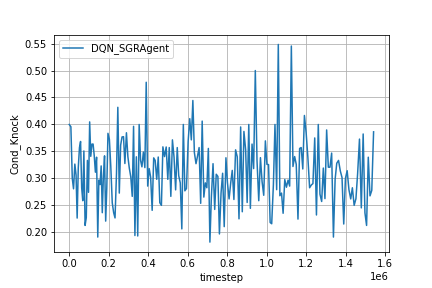

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST41 - replay_memory_size = 2000

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST41'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 2000


# The initial memory size
# default: 100
memory_init_size = 100000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 100000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  308427
  reward       |  -0.20300000000000018
  Avg Turns    |  15.44
  Cond_Knock   |  0.35
  Gin: 1 | Knock: 14 | Other: 85
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  315908
  reward       |  0.25389999999999974
  Avg Turns    |  29.8
  Cond_Knock   |  0.31223628691983124
  Gin: 7 | Knock: 74 | Other: 19
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  315908
  reward       |  0.0037999999999999852
  Avg Turns    |  20.73
  Cond_Knock   |  0.3308270676691729
  Gin: 4 | Knock: 44 | Other: 52
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  315908
  reward       |  -0.14830000000000013
  Avg Turns    |  16.97
  Cond

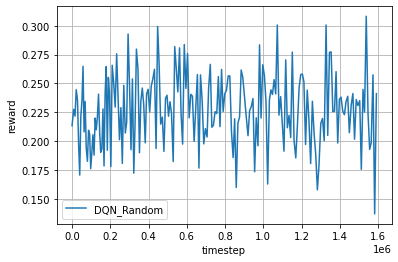

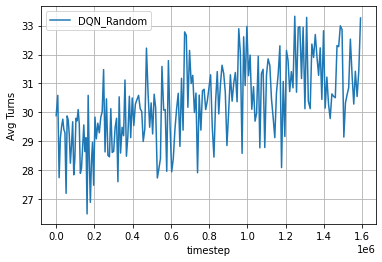

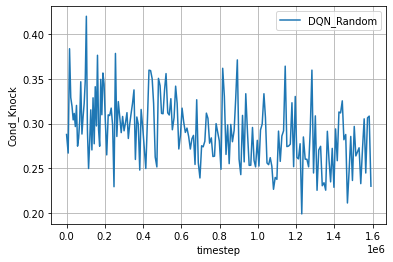

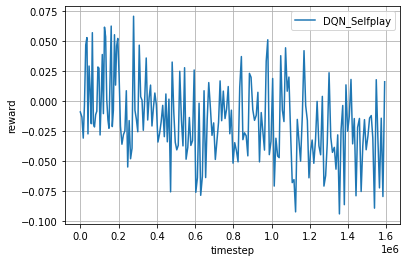

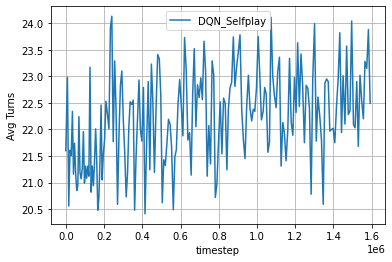

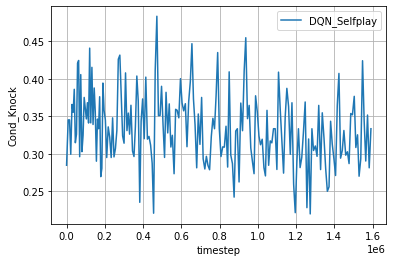

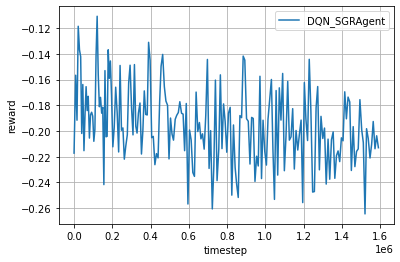

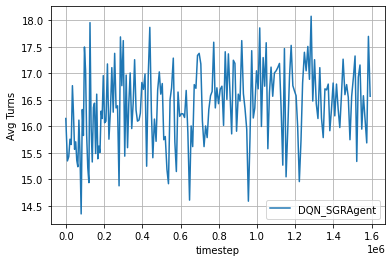

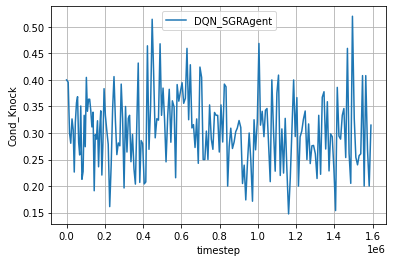

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 31.52,
 'Gin': 10,
 'Knock': 74,
 'Knock_Possible': 293,
 'Other': 16}

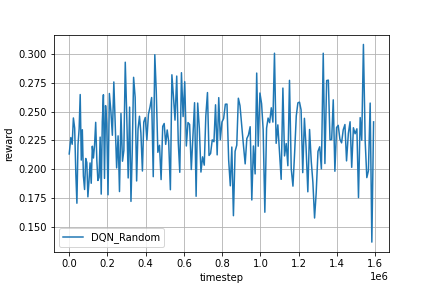

In [ ]:
Image(log_dir + '/rand_fig.png')

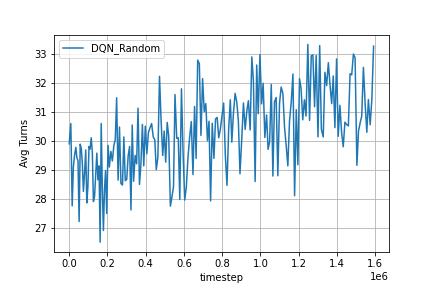

In [ ]:
Image(log_dir + '/rand_fig2.png')

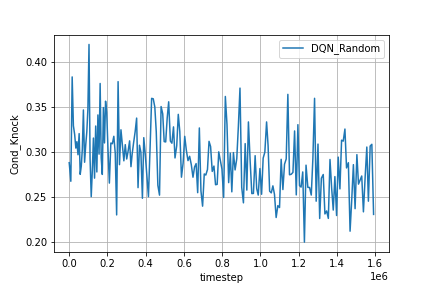

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 22.16, 'Gin': 1, 'Knock': 37, 'Knock_Possible': 112, 'Other': 62}

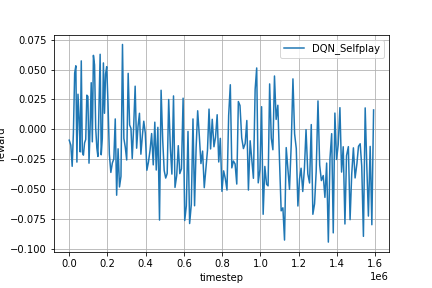

In [ ]:
Image(log_dir + '/self_fig.png')

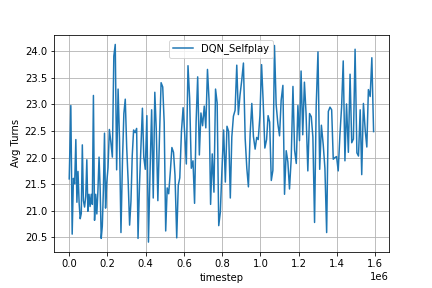

In [ ]:
Image(log_dir + '/self_fig2.png')

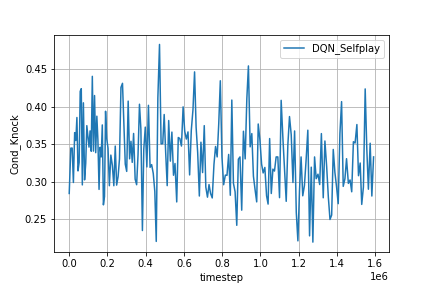

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 15.88, 'Gin': 0, 'Knock': 18, 'Knock_Possible': 52, 'Other': 82}

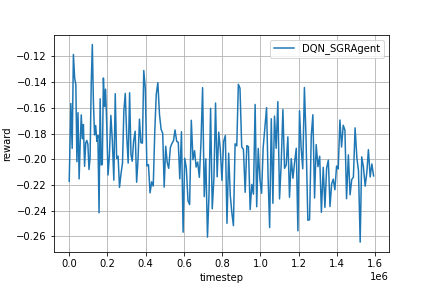

In [ ]:
Image(log_dir + '/sgr_fig.png')

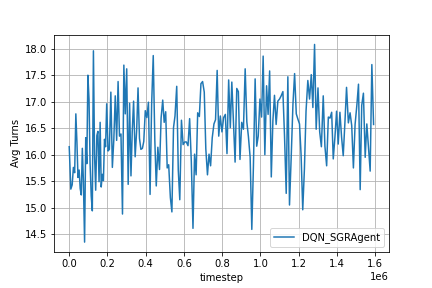

In [ ]:
Image(log_dir + '/sgr_fig2.png')

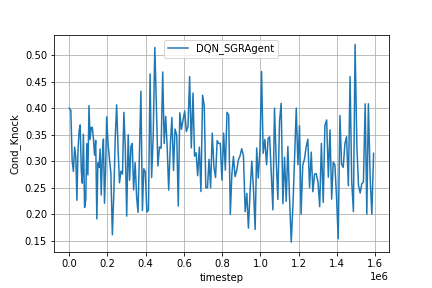

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST42 - replay_memory_size = 200000

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST42'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 200000


# The initial memory size
# default: 100
memory_init_size = 100000

# default: 32
batch_size = 32

# Train the agent every X steps
# default: 1
train_every = 100000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  317643
  reward       |  -0.1806
  Avg Turns    |  16.28
  Cond_Knock   |  0.2553191489361702
  Gin: 4 | Knock: 12 | Other: 84
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  325873
  reward       |  0.22429999999999983
  Avg Turns    |  30.57
  Cond_Knock   |  0.35514018691588783
  Gin: 10 | Knock: 76 | Other: 14
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  325873
  reward       |  0.013000000000000006
  Avg Turns    |  21.62
  Cond_Knock   |  0.37755102040816324
  Gin: 4 | Knock: 37 | Other: 59
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  325873
  reward       |  -0.15430000000000008
  Avg Turns    |  16.97
  C

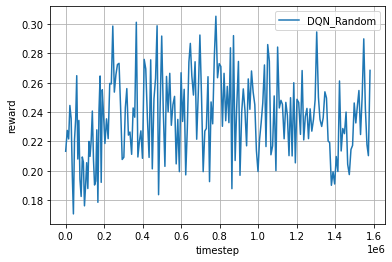

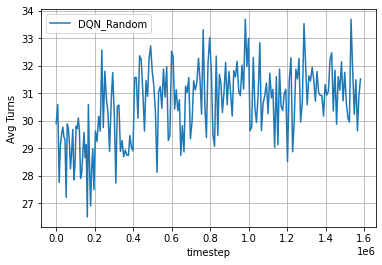

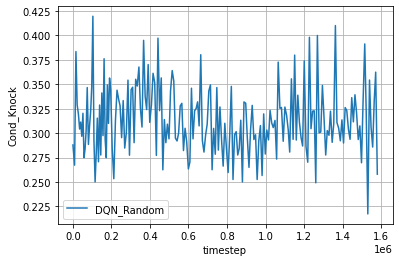

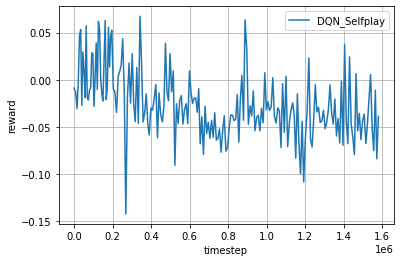

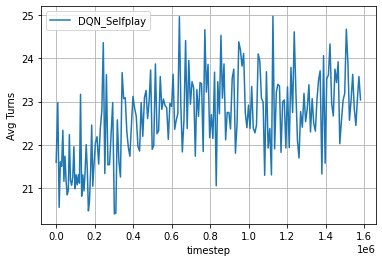

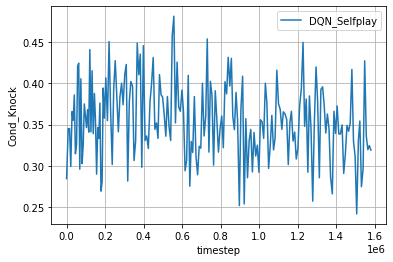

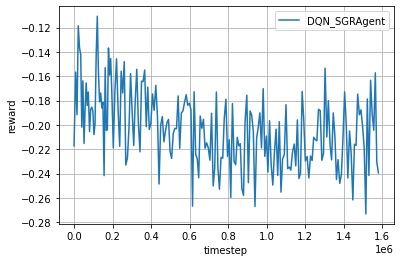

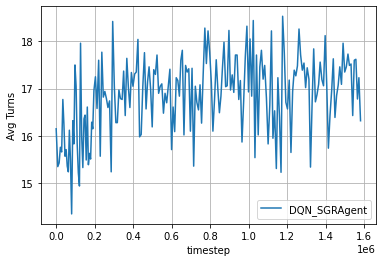

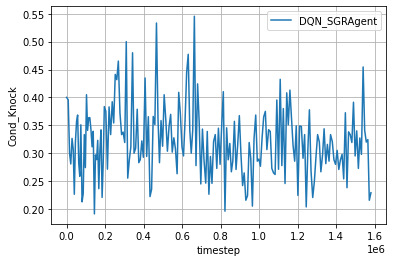

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 31.97, 'Gin': 7, 'Knock': 76, 'Knock_Possible': 263, 'Other': 17}

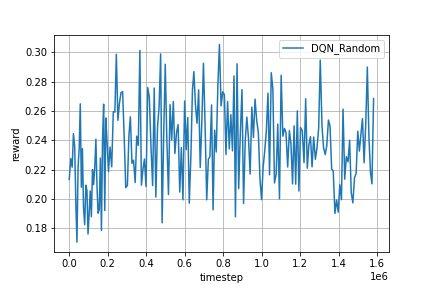

In [ ]:
Image(log_dir + '/rand_fig.png')

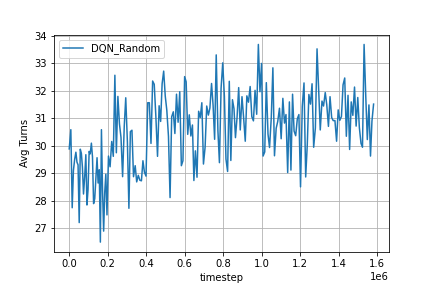

In [ ]:
Image(log_dir + '/rand_fig2.png')

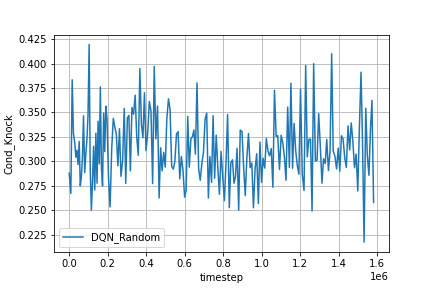

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 22.39, 'Gin': 3, 'Knock': 26, 'Knock_Possible': 75, 'Other': 71}

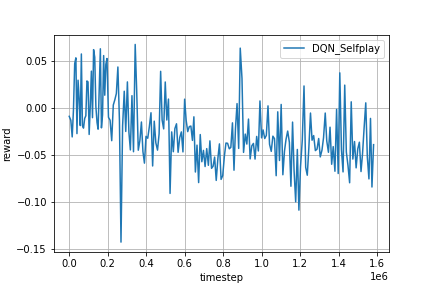

In [ ]:
Image(log_dir + '/self_fig.png')

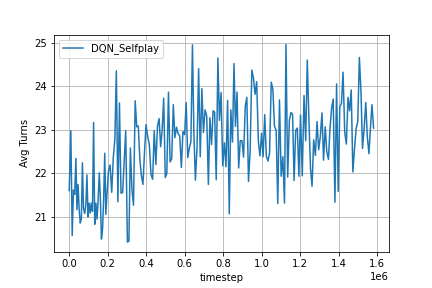

In [ ]:
Image(log_dir + '/self_fig2.png')

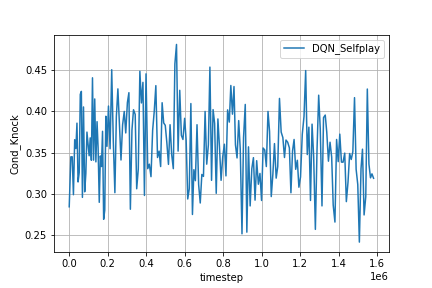

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 16.54, 'Gin': 2, 'Knock': 19, 'Knock_Possible': 48, 'Other': 79}

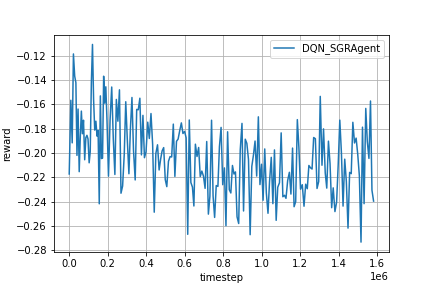

In [ ]:
Image(log_dir + '/sgr_fig.png')

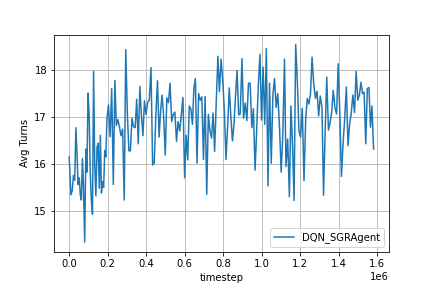

In [ ]:
Image(log_dir + '/sgr_fig2.png')

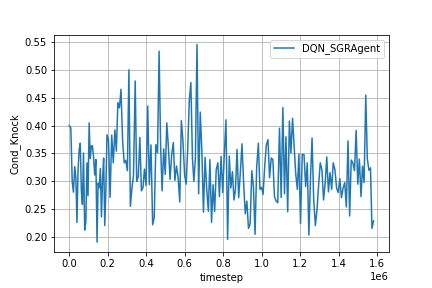

In [ ]:
Image(log_dir + '/sgr_fig3.png')

# Final

## TEST99

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST99'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100  # mahjong_dqn has 1000
episode_num = 50000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
# learning_rate = 5e-7
learning_rate = 1e-6

# replay_memory_size
# default: 20000
replay_memory_size = 20000


# The initial memory size
# default: 100
memory_init_size = 10000

# default: 32
batch_size = 64

# Train the agent every X steps
# default: 1
train_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=1000,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=1000,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  3348610
  reward       |  -0.23570000000000005
  Avg Turns    |  18.32
  Cond_Knock   |  0.06818181818181818
  Gin: 2 | Knock: 3 | Other: 95
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  3358837
  reward       |  0.38729999999999976
  Avg Turns    |  41.84
  Cond_Knock   |  0.09345794392523364
  Gin: 30 | Knock: 50 | Other: 20
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  3358837
  reward       |  -0.08970000000000006
  Avg Turns    |  26.29
  Cond_Knock   |  0.1743119266055046
  Gin: 5 | Knock: 19 | Other: 76
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  3358837
  reward       |  -0.2606000000000001
  Avg Turns 

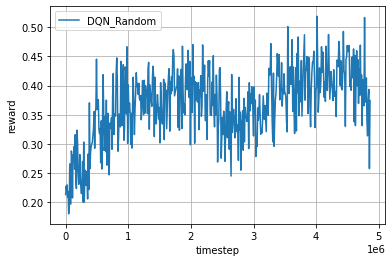

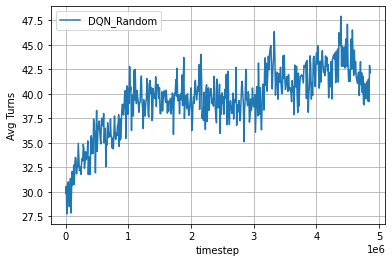

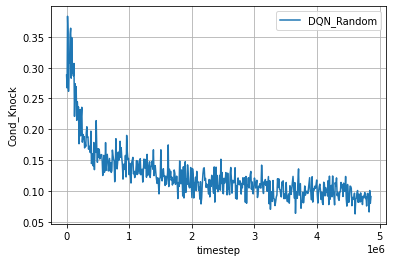

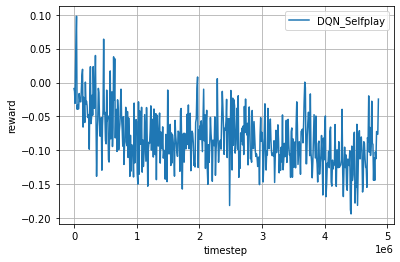

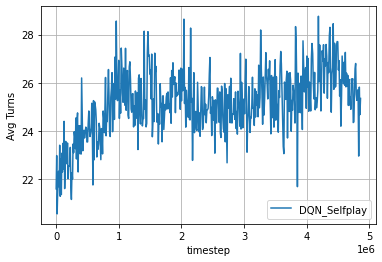

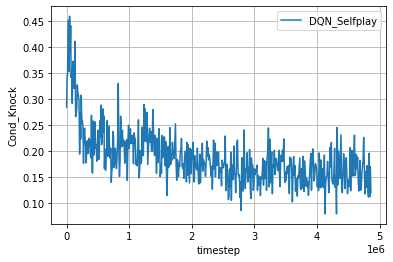

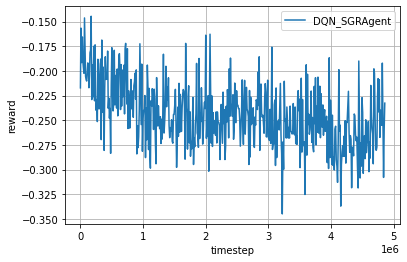

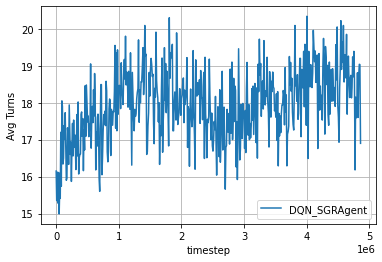

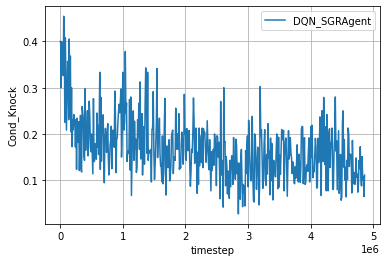

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 41.67,
 'Gin': 33,
 'Knock': 47,
 'Knock_Possible': 497,
 'Other': 20}

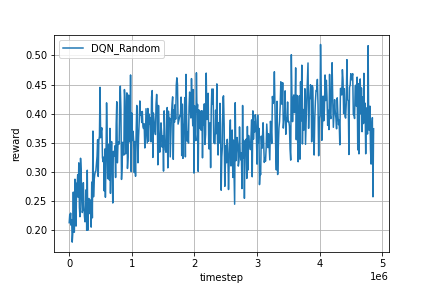

In [ ]:
Image(log_dir + '/rand_fig.png')

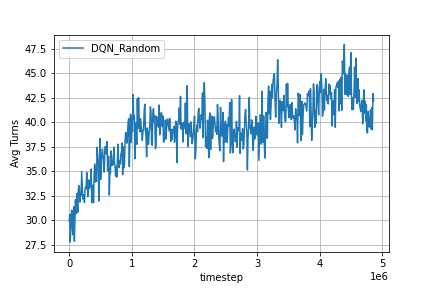

In [ ]:
Image(log_dir + '/rand_fig2.png')

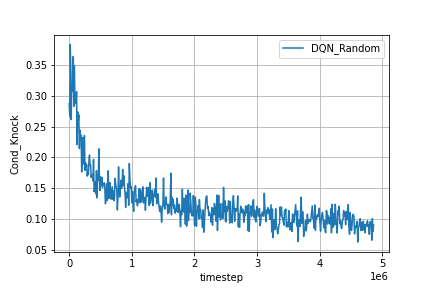

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 25.2, 'Gin': 6, 'Knock': 28, 'Knock_Possible': 155, 'Other': 66}

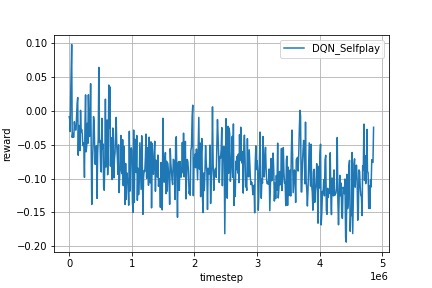

In [ ]:
Image(log_dir + '/self_fig.png')

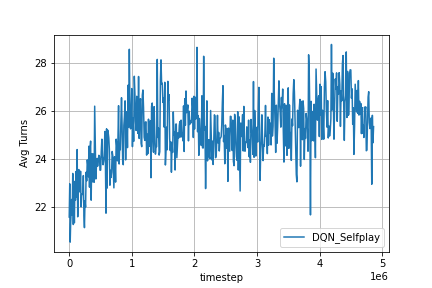

In [ ]:
Image(log_dir + '/self_fig2.png')

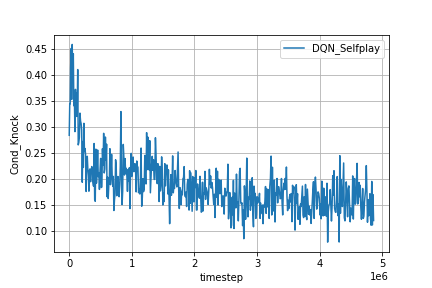

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 17.22, 'Gin': 0, 'Knock': 6, 'Knock_Possible': 47, 'Other': 94}

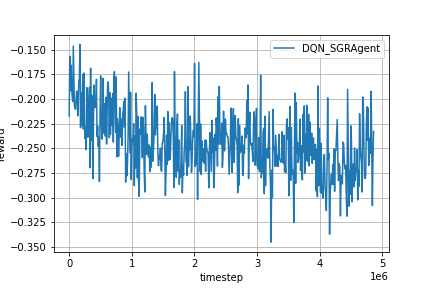

In [ ]:
Image(log_dir + '/sgr_fig.png')

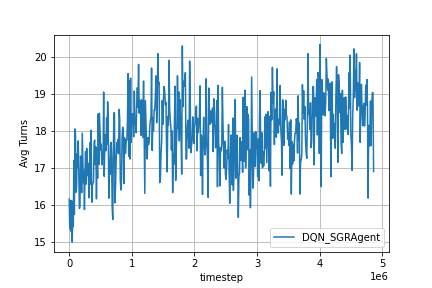

In [ ]:
Image(log_dir + '/sgr_fig2.png')

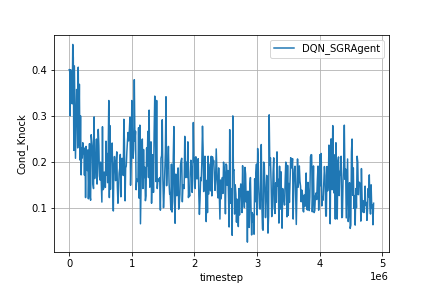

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST98

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST98'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 100
evaluate_num = 100
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 20000

# The initial memory size
# default: 100
memory_init_size = 10000

# default: 32
batch_size = 1000

# Train the agent every X steps
# default: 1
train_every = 10000


# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v5
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop



----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  136
  reward       |  0.21329999999999985
  Avg Turns    |  29.89
  Cond_Knock   |  0.2878787878787879
  Gin: 4 | Knock: 76 | Other: 20
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  136
  reward       |  -0.008899999999999993
  Avg Turns    |  21.6
  Cond_Knock   |  0.2846715328467153
  Gin: 4 | Knock: 39 | Other: 57
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  136
  reward       |  -0.2172000000000001
  Avg Turns    |  16.15
  Cond_Knock   |  0.4
  Gin: 0 | Knock: 18 | Other: 82
----------------------------------------
INFO - Agent dqn, step 10000, rl-loss: 0.0021003747824579477
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 30000, rl-loss: 0.0029811060521751642

--------------------------

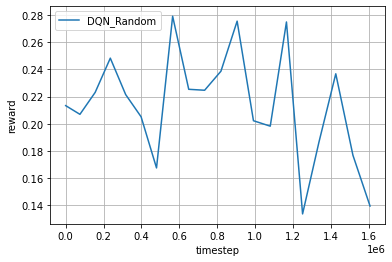

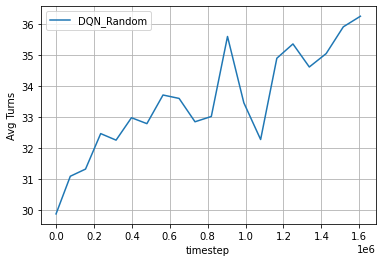

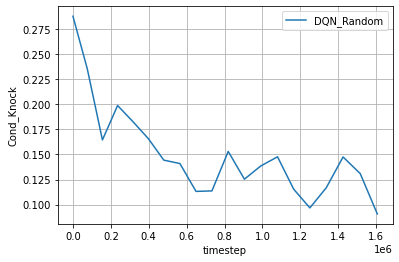

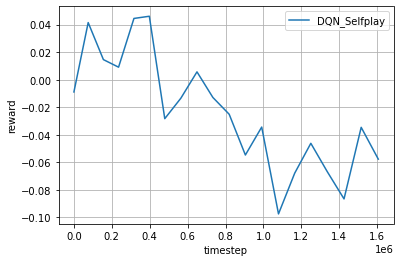

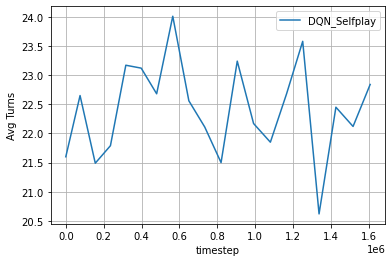

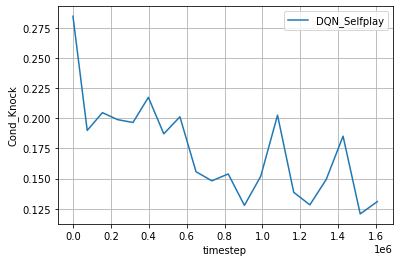

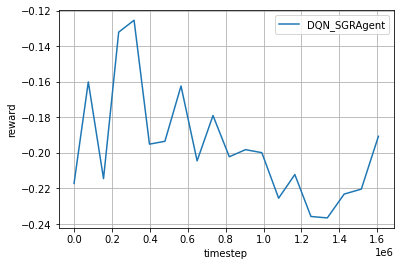

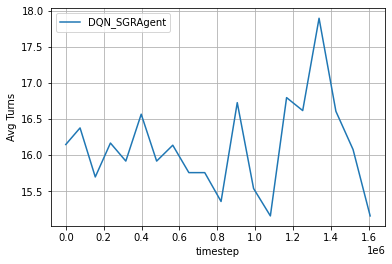

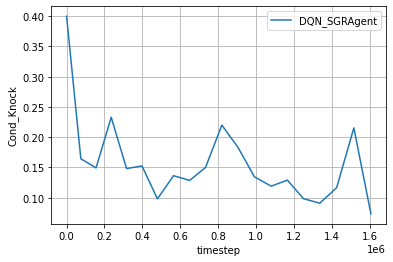

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 35.29,
 'Gin': 18,
 'Knock': 43,
 'Knock_Possible': 405,
 'Other': 39}

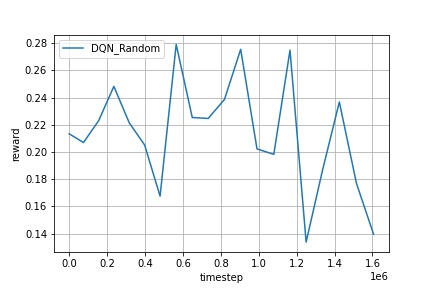

In [ ]:
Image(log_dir + '/rand_fig.png')

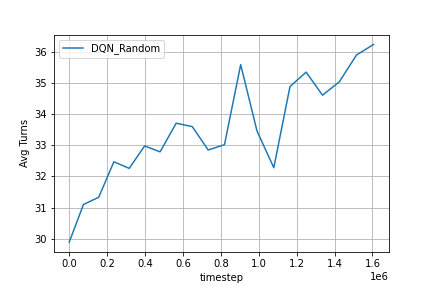

In [ ]:
Image(log_dir + '/rand_fig2.png')

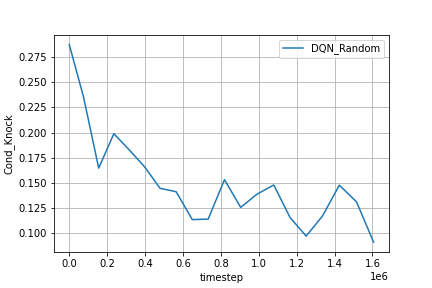

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 23.97, 'Gin': 7, 'Knock': 23, 'Knock_Possible': 141, 'Other': 70}

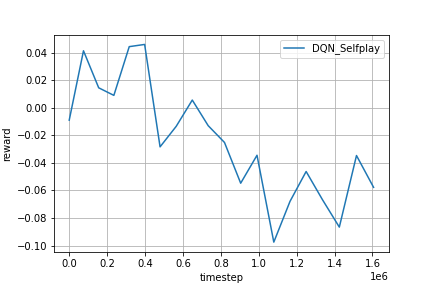

In [ ]:
Image(log_dir + '/self_fig.png')

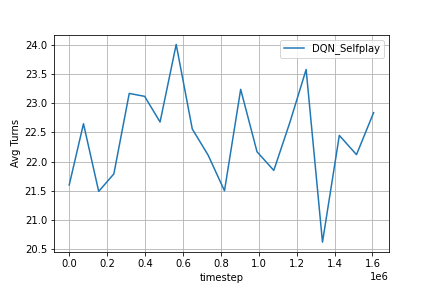

In [ ]:
Image(log_dir + '/self_fig2.png')

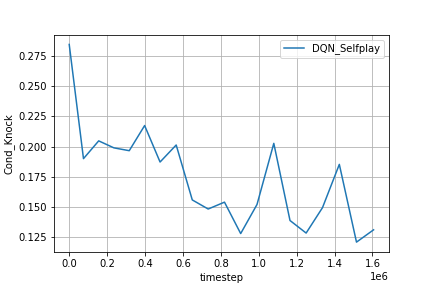

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 16.96, 'Gin': 3, 'Knock': 10, 'Knock_Possible': 79, 'Other': 87}

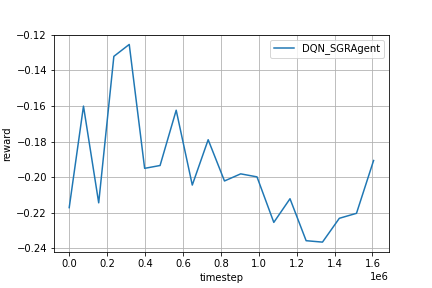

In [ ]:
Image(log_dir + '/sgr_fig.png')

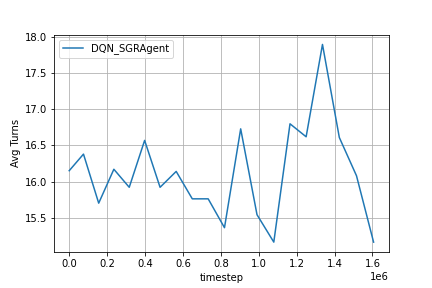

In [ ]:
Image(log_dir + '/sgr_fig2.png')

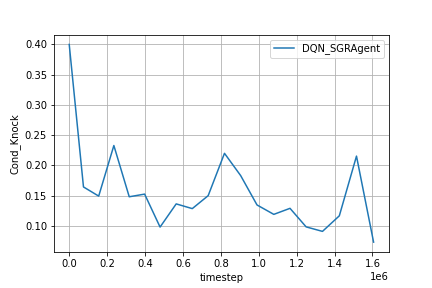

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST97 - 10 knock reward, no neg reward (v5)

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST97'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 1000
evaluate_num = 100
episode_num = 20000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 20000

# The initial memory size
# default: 100
memory_init_size = 10000

# default: 32
batch_size = 1000

# Train the agent every X steps
# default: 1
train_every = 10000


# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
payoff_fnc = get_payoff_gin_rummy_v5
cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
# cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop



----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  136
  reward       |  7.2
  Avg Turns    |  29.89
  Cond_Knock   |  0.2878787878787879
  Gin: 4 | Knock: 76 | Other: 20
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  136
  reward       |  4.14
  Avg Turns    |  21.6
  Cond_Knock   |  0.2846715328467153
  Gin: 4 | Knock: 39 | Other: 57
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  136
  reward       |  1.61
  Avg Turns    |  16.15
  Cond_Knock   |  0.4
  Gin: 0 | Knock: 18 | Other: 82
----------------------------------------
INFO - Agent dqn, step 10000, rl-loss: 0.9979979991912842
INFO - Copied model parameters to target network.
INFO - Agent dqn, step 30000, rl-loss: 1.7975938320159912

----------------------------------------------------------------------

Random:


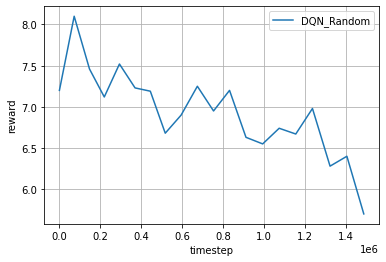

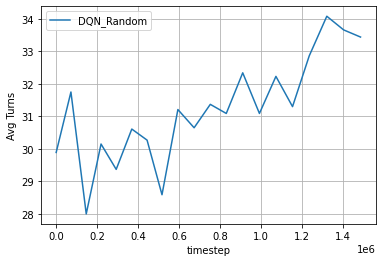

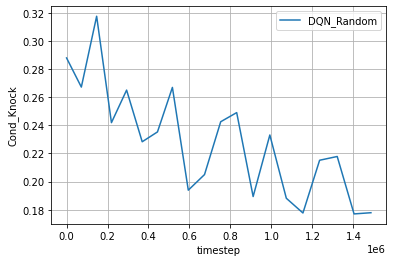

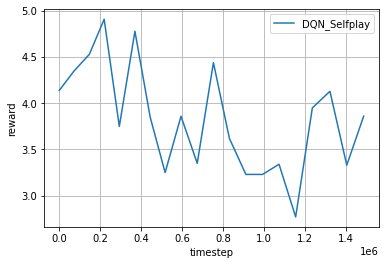

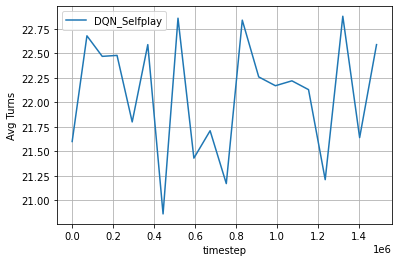

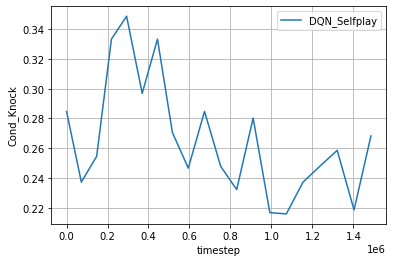

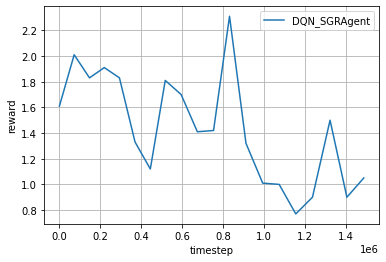

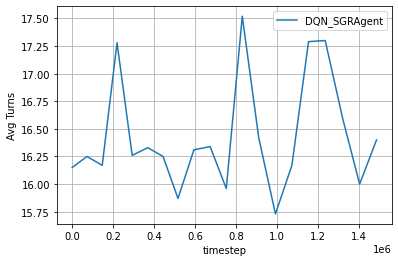

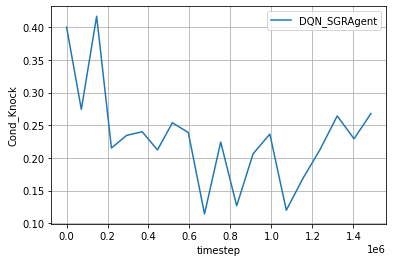

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 32.33,
 'Gin': 24,
 'Knock': 55,
 'Knock_Possible': 351,
 'Other': 21}

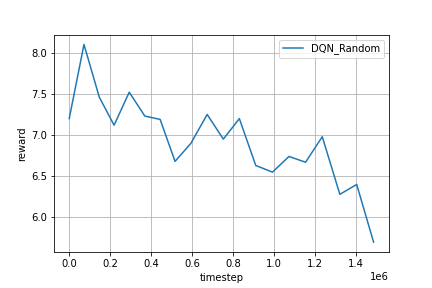

In [ ]:
Image(log_dir + '/rand_fig.png')

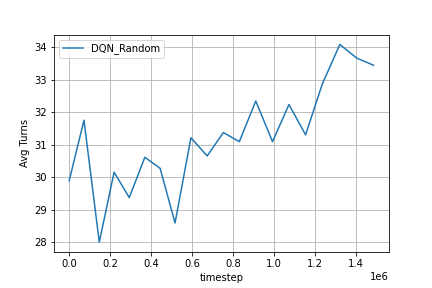

In [ ]:
Image(log_dir + '/rand_fig2.png')

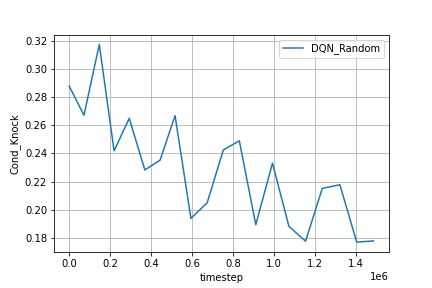

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 21.6, 'Gin': 3, 'Knock': 29, 'Knock_Possible': 129, 'Other': 68}

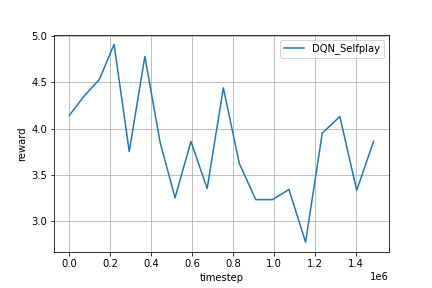

In [ ]:
Image(log_dir + '/self_fig.png')

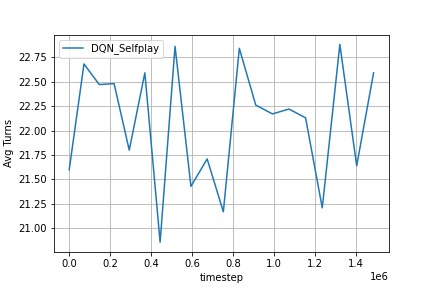

In [ ]:
Image(log_dir + '/self_fig2.png')

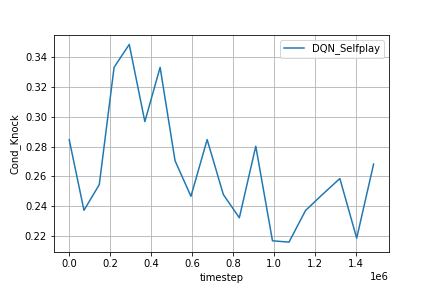

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 17.15, 'Gin': 3, 'Knock': 16, 'Knock_Possible': 70, 'Other': 81}

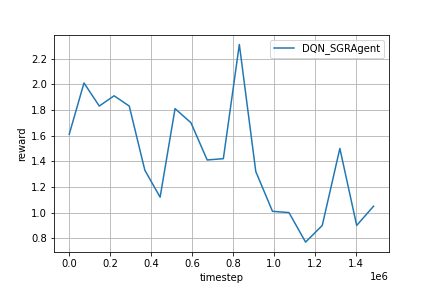

In [ ]:
Image(log_dir + '/sgr_fig.png')

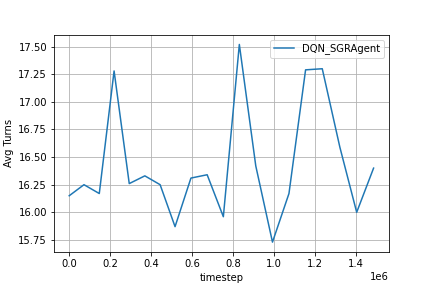

In [ ]:
Image(log_dir + '/sgr_fig2.png')

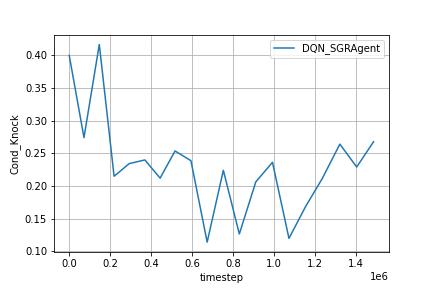

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST96 - 10 knock onward (v4)

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K'
dqn_model_name = 'TEST96'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 200    # how frequent to check
evaluate_num = 100  # how many games
episode_num = 40000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 200000

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 1000

# Train the agent every X steps
# default: 1
train_every = 100000


# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
payoff_fnc = get_payoff_gin_rummy_v4
cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
# cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  736319
  reward       |  1.6005999999999998
  Avg Turns    |  15.12
  Cond_Knock   |  0.13432835820895522
  Gin: 1 | Knock: 9 | Other: 90
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  751956
  reward       |  6.178399999999999
  Avg Turns    |  29.74
  Cond_Knock   |  0.2292358803986711
  Gin: 11 | Knock: 69 | Other: 20
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  751956
  reward       |  3.8273
  Avg Turns    |  20.87
  Cond_Knock   |  0.2679738562091503
  Gin: 9 | Knock: 41 | Other: 50
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  751956
  reward       |  1.6467999999999998
  Avg Turns    |  16.02
  Cond_Knock

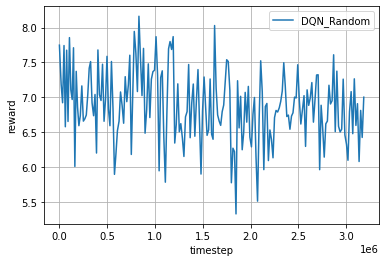

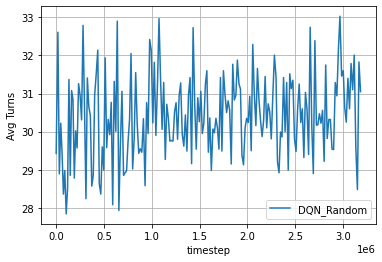

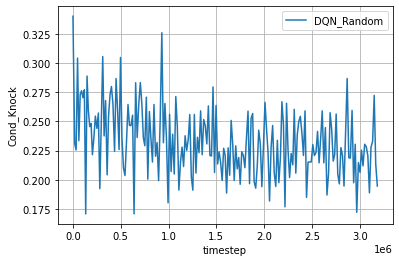

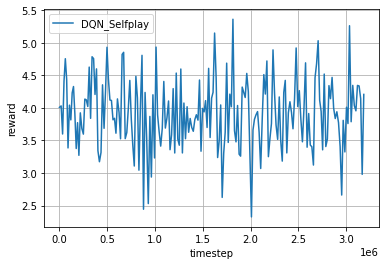

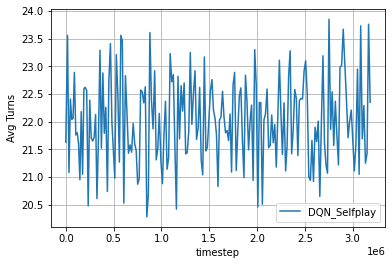

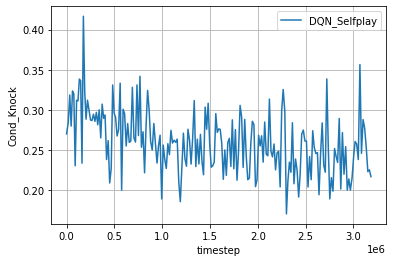

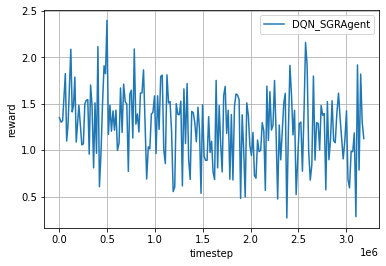

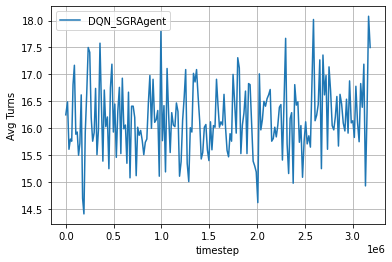

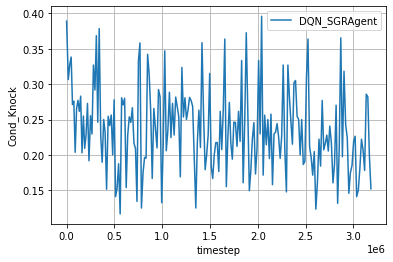

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 28.75,
 'Gin': 18,
 'Knock': 65,
 'Knock_Possible': 256,
 'Other': 17}

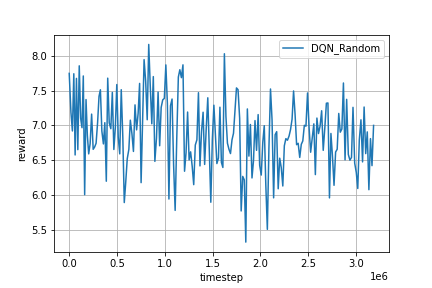

In [ ]:
Image(log_dir + '/rand_fig.png')

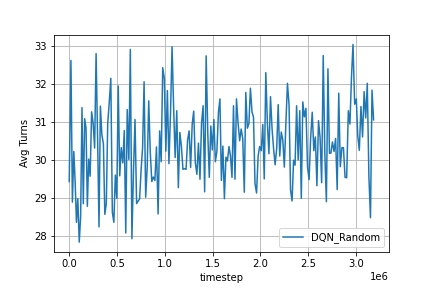

In [ ]:
Image(log_dir + '/rand_fig2.png')

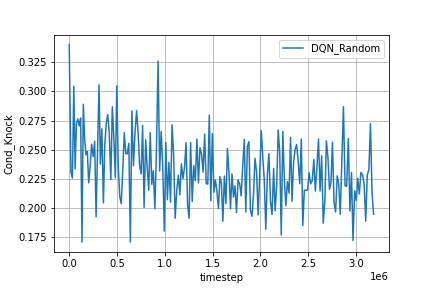

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 22.18, 'Gin': 6, 'Knock': 44, 'Knock_Possible': 184, 'Other': 50}

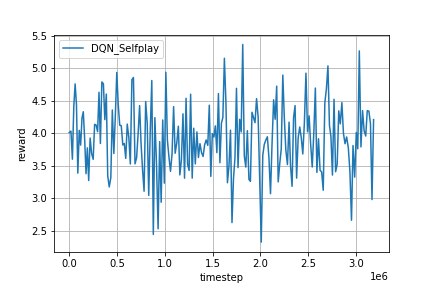

In [ ]:
Image(log_dir + '/self_fig.png')

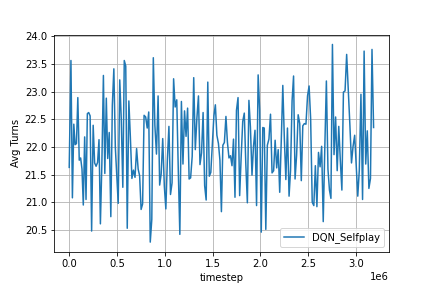

In [ ]:
Image(log_dir + '/self_fig2.png')

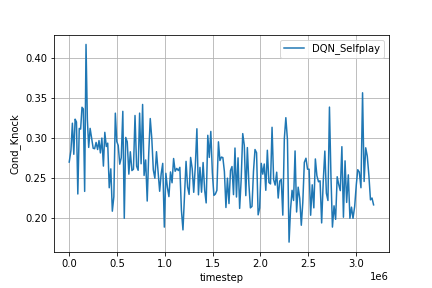

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 16.3, 'Gin': 4, 'Knock': 21, 'Knock_Possible': 86, 'Other': 75}

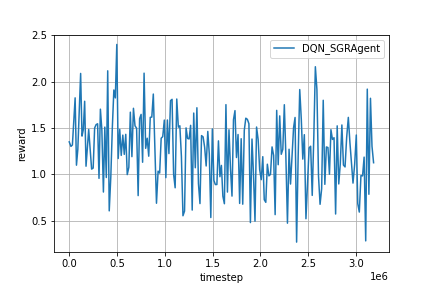

In [ ]:
Image(log_dir + '/sgr_fig.png')

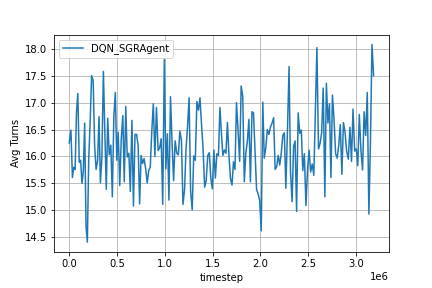

In [ ]:
Image(log_dir + '/sgr_fig2.png')

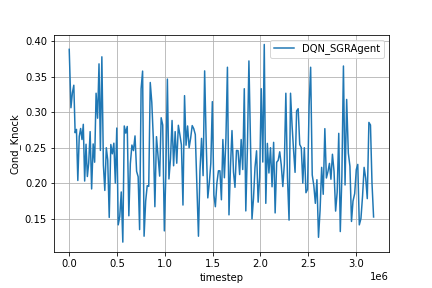

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST95 - 2K Base onwards

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K_2K_base'
dqn_model_name = 'TEST95'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 200    # how frequent to check
evaluate_num = 100  # how many games
episode_num = 40000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 200000

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 1000

# Train the agent every X steps
# default: 1
train_every = 100000


# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
payoff_fnc = get_payoff_gin_rummy_v4
cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
# cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  596637
  reward       |  2.6995
  Avg Turns    |  15.15
  Cond_Knock   |  0.62
  Gin: 1 | Knock: 31 | Other: 68
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  609535
  reward       |  8.214
  Avg Turns    |  26.91
  Cond_Knock   |  0.5584415584415584
  Gin: 1 | Knock: 86 | Other: 13
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  609535
  reward       |  4.9749
  Avg Turns    |  18.63
  Cond_Knock   |  0.7325581395348837
  Gin: 2 | Knock: 63 | Other: 35
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  609535
  reward       |  2.4418
  Avg Turns    |  14.41
  Cond_Knock   |  0.7083333333333334
  Gin: 0 | Knock: 34 | Oth

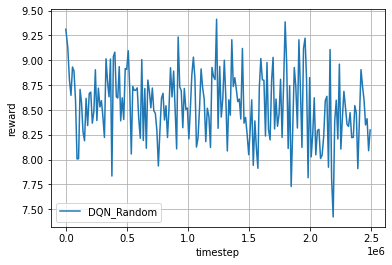

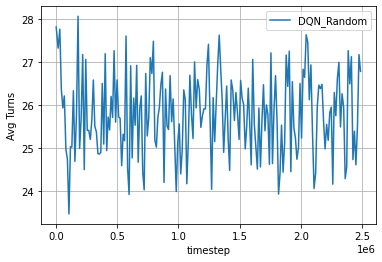

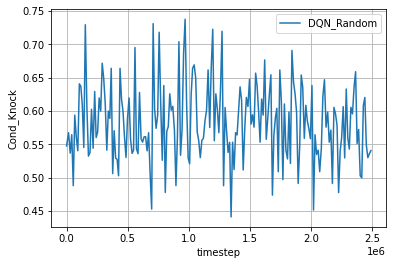

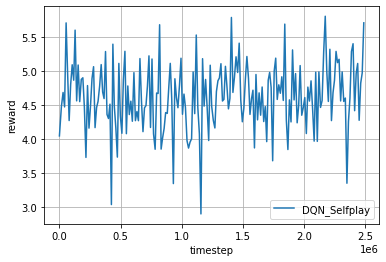

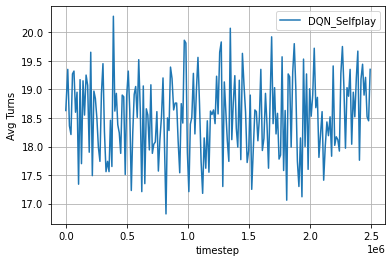

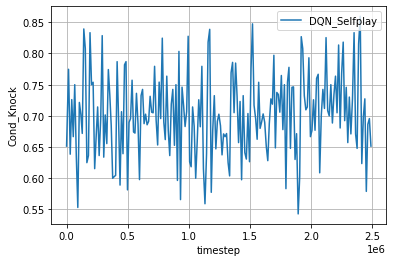

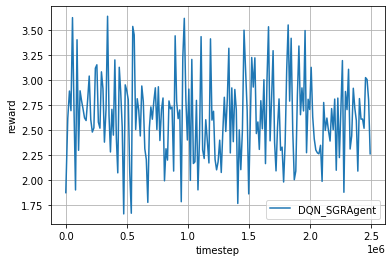

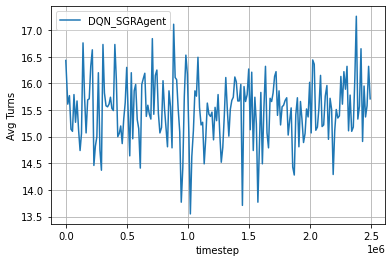

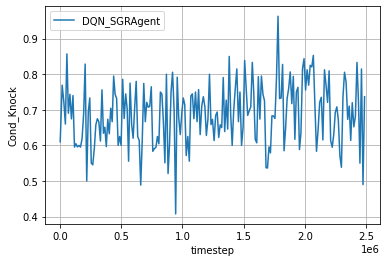

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 25.24, 'Gin': 3, 'Knock': 87, 'Knock_Possible': 148, 'Other': 10}

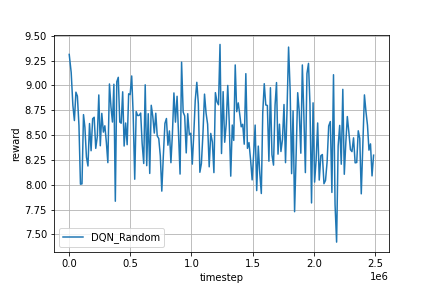

In [ ]:
Image(log_dir + '/rand_fig.png')

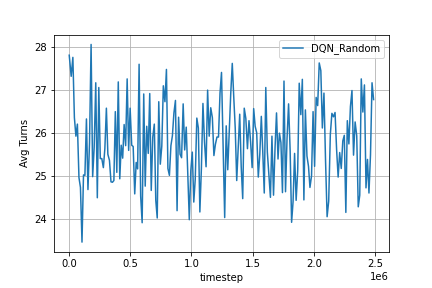

In [ ]:
Image(log_dir + '/rand_fig2.png')

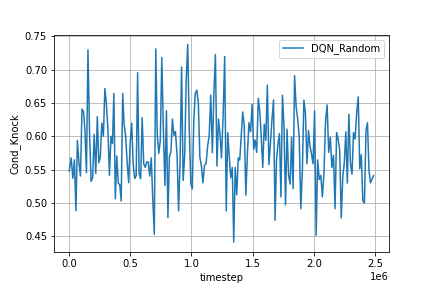

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 19.28, 'Gin': 2, 'Knock': 54, 'Knock_Possible': 84, 'Other': 44}

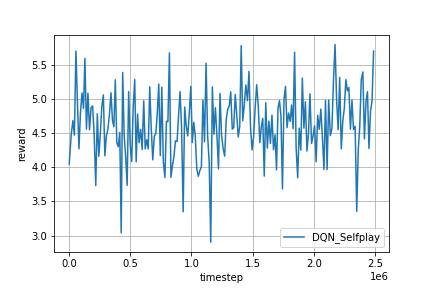

In [ ]:
Image(log_dir + '/self_fig.png')

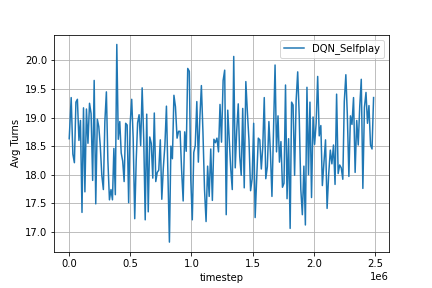

In [ ]:
Image(log_dir + '/self_fig2.png')

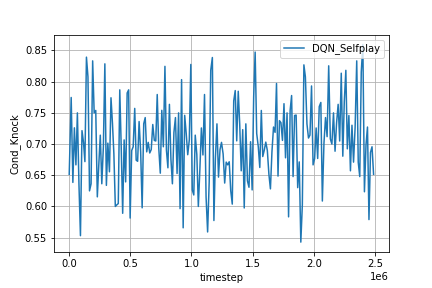

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 15.2, 'Gin': 1, 'Knock': 28, 'Knock_Possible': 32, 'Other': 71}

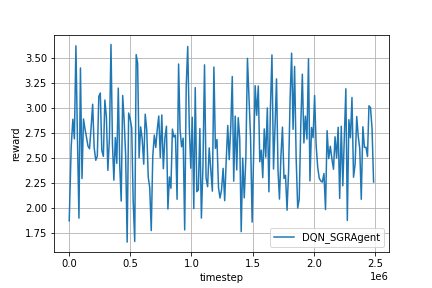

In [ ]:
Image(log_dir + '/sgr_fig.png')

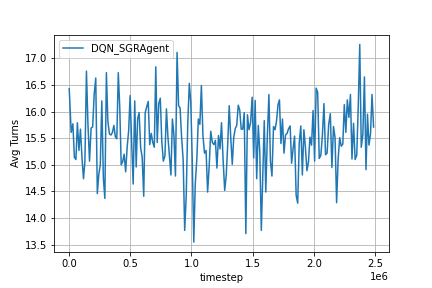

In [ ]:
Image(log_dir + '/sgr_fig2.png')

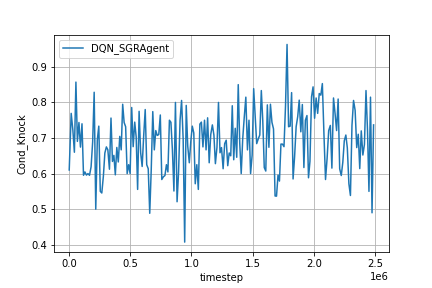

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST94 - regular rewards

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K_2K_base'
dqn_model_name = 'TEST94'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 200    # how frequent to check
evaluate_num = 100  # how many games
episode_num = 40000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 200000

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 1000

# Train the agent every X steps
# default: 1
train_every = 100000


# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v4
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.

----------------------------------------
  timestep     |  600783
  reward       |  -0.12690000000000007
  Avg Turns    |  15.41
  Cond_Knock   |  0.5714285714285714
  Gin: 0 | Knock: 28 | Other: 72
----------------------------------------


----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  613106
  reward       |  0.18249999999999963
  Avg Turns    |  25.4
  Cond_Knock   |  0.5629139072847682
  Gin: 4 | Knock: 85 | Other: 11
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  613106
  reward       |  -0.020299999999999943
  Avg Turns    |  18.77
  Cond_Knock   |  0.7532467532467533
  Gin: 2 | Knock: 58 | Other: 40
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  613106
  reward       |  -0.08429999999999994
  Avg Turns    | 

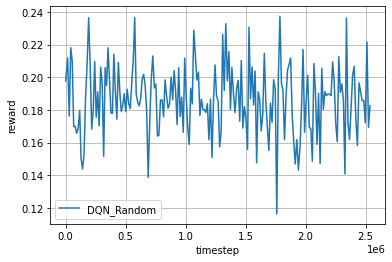

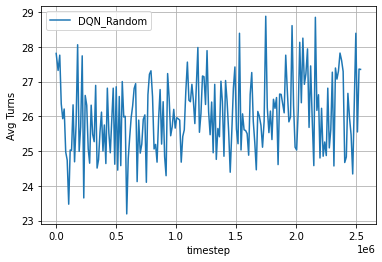

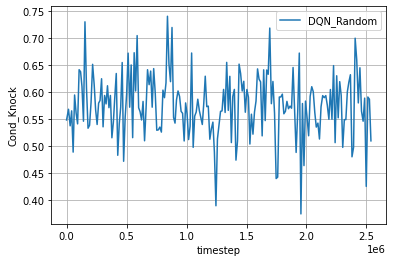

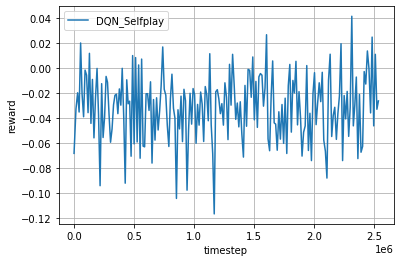

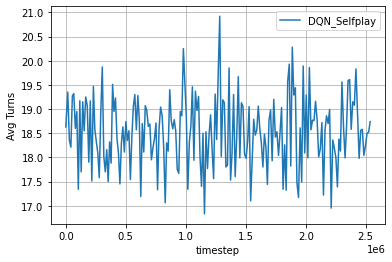

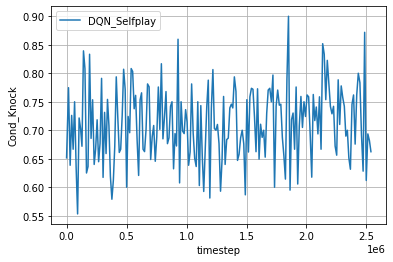

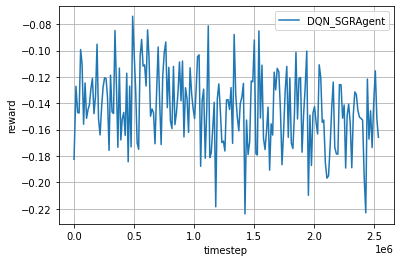

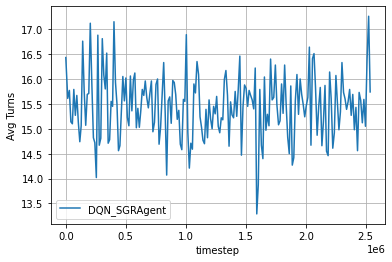

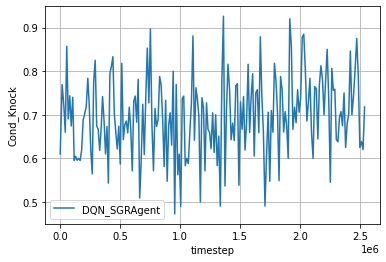

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 25.31, 'Gin': 6, 'Knock': 80, 'Knock_Possible': 143, 'Other': 14}

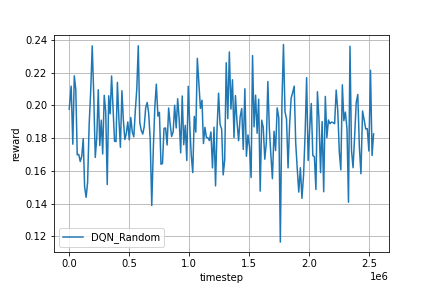

In [ ]:
Image(log_dir + '/rand_fig.png')

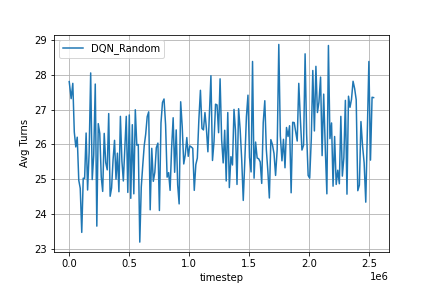

In [ ]:
Image(log_dir + '/rand_fig2.png')

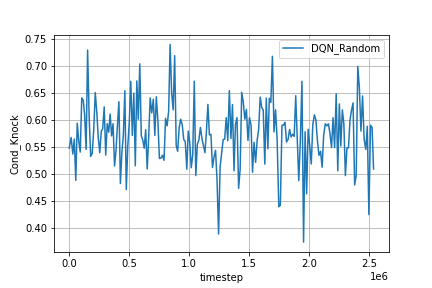

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 18.89, 'Gin': 2, 'Knock': 52, 'Knock_Possible': 86, 'Other': 46}

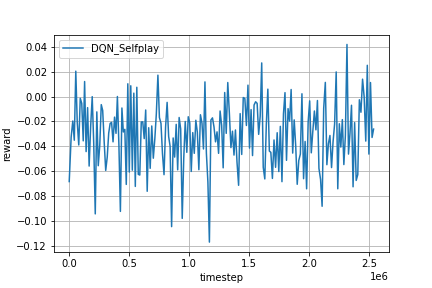

In [ ]:
Image(log_dir + '/self_fig.png')

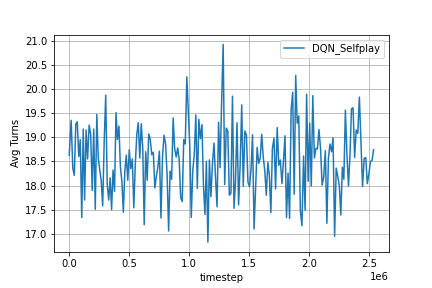

In [ ]:
Image(log_dir + '/self_fig2.png')

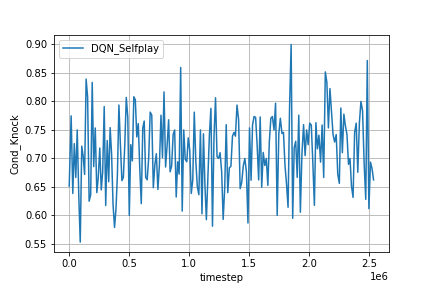

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 15.2, 'Gin': 2, 'Knock': 30, 'Knock_Possible': 39, 'Other': 68}

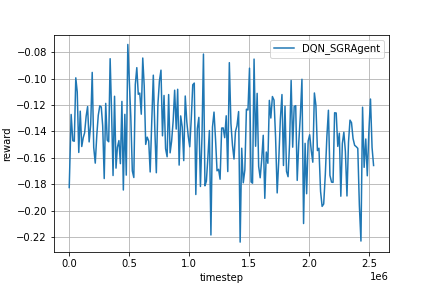

In [ ]:
Image(log_dir + '/sgr_fig.png')

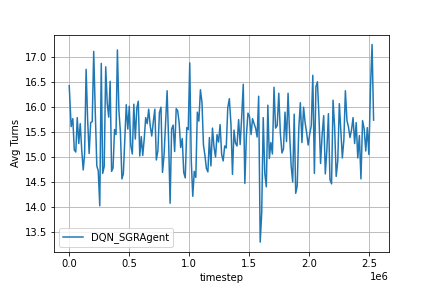

In [ ]:
Image(log_dir + '/sgr_fig2.png')

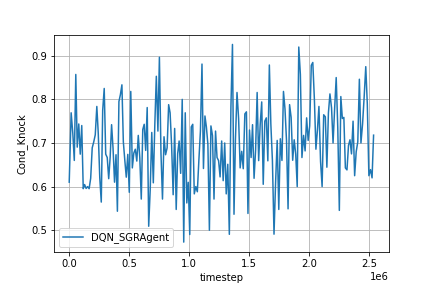

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST93 - train_every more often...

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K_2K_base'
dqn_model_name = 'TEST93'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 200    # how frequent to check
evaluate_num = 100  # how many games
episode_num = 40000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
learning_rate = 5e-7

# replay_memory_size
# default: 20000
replay_memory_size = 200000

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 1000

# Train the agent every X steps
# default: 1
train_every = 100


# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v4
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False


### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
  timestep     |  711612
  reward       |  -0.2630000000000002
  Avg Turns    |  13.92
  Cond_Knock   |  0.625
  Gin: 0 | Knock: 10 | Other: 90
----------------------------------------
INFO - Agent dqn, step 365100, rl-loss: 0.005311831831932068

----------------------------------------------------------------------

Random:

----------------------------------------
  timestep     |  726642
  reward       |  0.11129999999999989
  Avg Turns    |  31.14
  Cond_Knock   |  0.38125
  Gin: 6 | Knock: 61 | Other: 33
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  726642
  reward       |  -0.1652000000000002
  Avg Turns    |  20.06
  Cond_Knock   |  0.4925373134328358
  Gin: 1 | Knock: 33 | Other: 66
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  726642
  reward       |  -0.26530000000000015
  Avg Turns    |  13.74
 

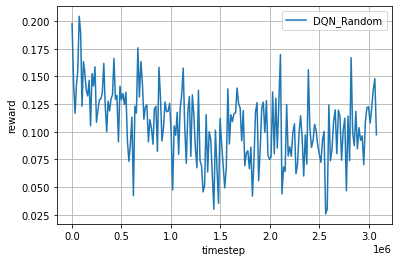

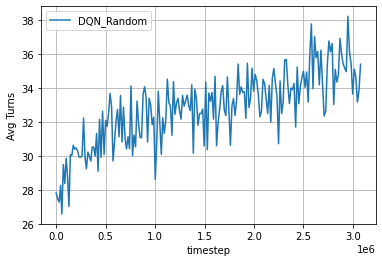

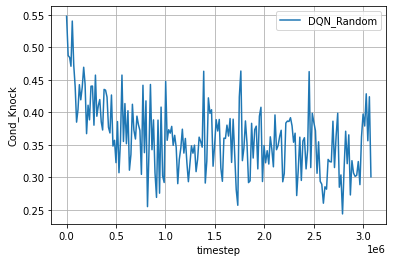

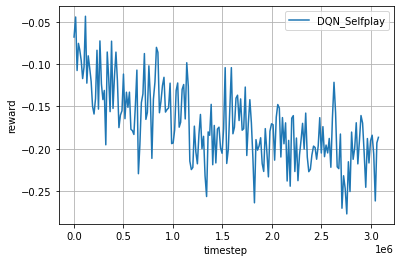

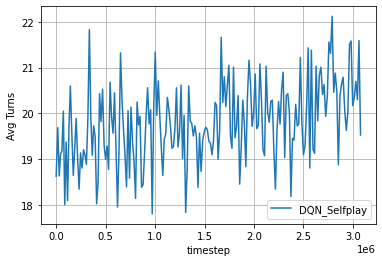

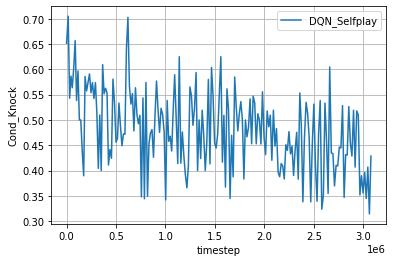

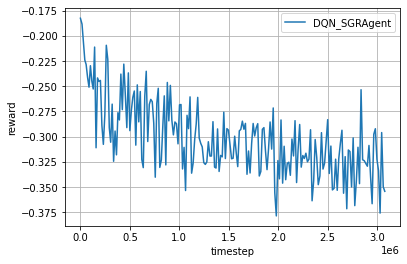

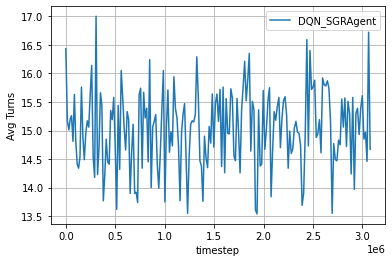

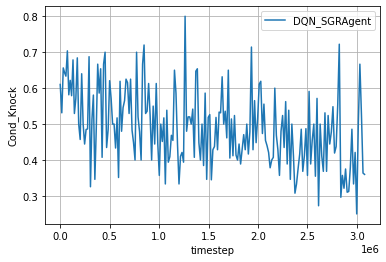

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand = -10000
max_reward_self = -10000
max_reward_sgr = -10000

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        # logger.log_performance(env.timestep, tournament(eval_env, evaluate_num)[0])
        # logger.log_performance2(env.timestep, 
        #                         tournament(SGRAgent_env, evaluate_num)[0],
        #                         tournament2(SGRAgent_env, evaluate_num))

        print('\n')
        print('----------------------------------------------------------------------')
        print('\nRandom:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        logger_rand.log_performance2(env.timestep, 
                                     reward_rand,
                                     tournament2(random_env, evaluate_num))
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        logger_self.log_performance2(env.timestep, 
                                     reward_self,
                                     tournament2(selfplay_env, evaluate_num))
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        logger_sgr.log_performance2(env.timestep, 
                                    reward_sgr,
                                    tournament2(SGRAgent_env, evaluate_num))
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))

# Close files in the logger
# logger.close_files()
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
# logger.plot('DQN')
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 35.88, 'Gin': 4, 'Knock': 50, 'Knock_Possible': 164, 'Other': 46}

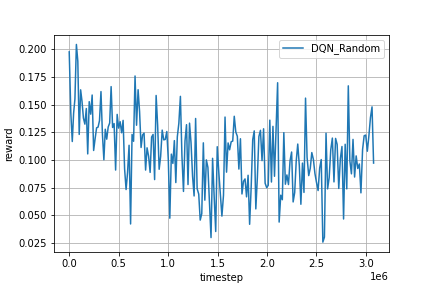

In [ ]:
Image(log_dir + '/rand_fig.png')

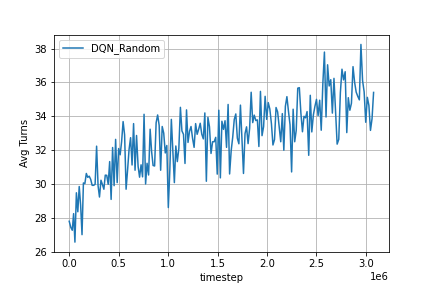

In [ ]:
Image(log_dir + '/rand_fig2.png')

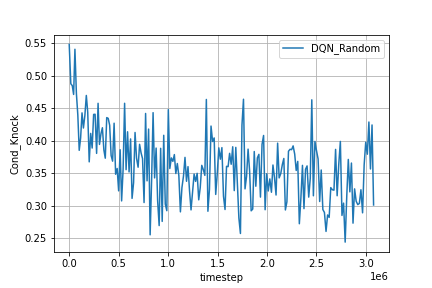

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 21.54, 'Gin': 0, 'Knock': 22, 'Knock_Possible': 53, 'Other': 78}

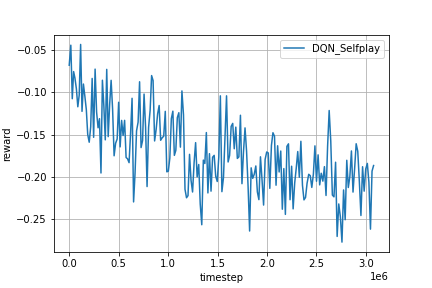

In [ ]:
Image(log_dir + '/self_fig.png')

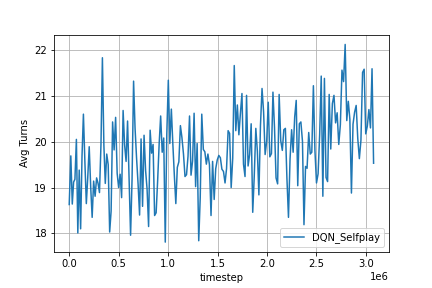

In [ ]:
Image(log_dir + '/self_fig2.png')

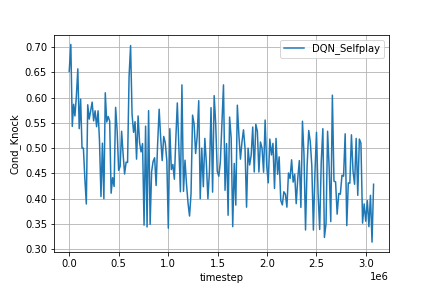

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 14.24, 'Gin': 0, 'Knock': 9, 'Knock_Possible': 32, 'Other': 91}

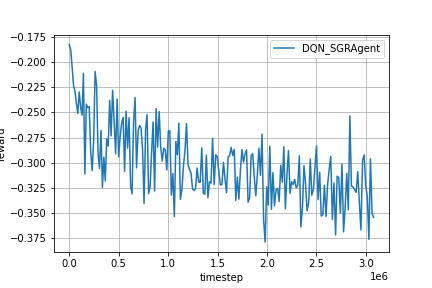

In [ ]:
Image(log_dir + '/sgr_fig.png')

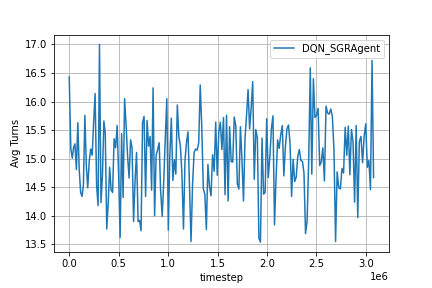

In [ ]:
Image(log_dir + '/sgr_fig2.png')

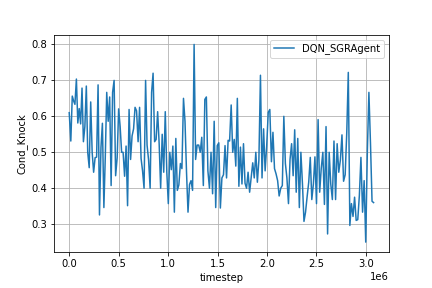

In [ ]:
Image(log_dir + '/sgr_fig3.png')

## TEST92

### Parameters

In [ ]:
# Pretrain model selection
state = 'all'
action = 'all'
model_name = 'all_states_all_actions_2hl_extra_knock_data_80K_2K_base'
dqn_model_name = 'TEST92'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Set the iterations numbers and how frequently we evaluate/save plot
evaluate_every = 200    # how frequent to check
evaluate_num = 100  # how many games
episode_num = 40000  # mahjong_dqn has 100000

# learning rate
# default: 0.00005 (5e-5)
# learning_rate = 0.00001 #1e-5
# learning_rate = 5e-7
learning_rate = 5e-8

# replay_memory_size
# default: 20000
replay_memory_size = 20000

# The initial memory size
# default: 100
memory_init_size = 1000

# default: 32
batch_size = 512

# Train the agent every X steps
# default: 1
train_every = 100

# update_target_estimator_every
# default: 1000
update_target_estimator_every = 10000

# Batch Normalization
batch_norm = False

# environment configs
# payoff_fnc = get_payoff_gin_rummy_v4
# cfg = {'seed': 0, 'payoff_fnc': payoff_fnc}
cfg = {'seed': 0}

### Environment Initialization

In [ ]:
from tensorflow.keras.backend import clear_session
clear_session()

# Make environments
env = rlcard.make('gin-rummy', config=cfg)

random_env = rlcard.make('gin-rummy', config=cfg)
selfplay_env = rlcard.make('gin-rummy', config=cfg)
SGRAgent_env = rlcard.make('gin-rummy', config=cfg)
env.game.settings.print_settings()

# The paths for saving the logs and learning curves
log_dir = './plots/dqn/random/{}'.format(dqn_model_name)

# Set a global seed
set_global_seed(0)

random_agent = RandomAgent(action_num=random_env.action_num)
SGRAgent = SimpleGinRummyAgent(action_num=SGRAgent_env.action_num)

agent = DQNAgent(scope='dqn',
                replay_memory_size=replay_memory_size,
                replay_memory_init_size=memory_init_size,       # default: 100
                update_target_estimator_every=update_target_estimator_every,
                discount_factor=0.99,
                epsilon_start=1.0,
                epsilon_end=0.1,
                epsilon_decay_steps=20000,
                batch_size=batch_size,                      # default: 32
                action_num=env.action_num,
                state_shape=env.state_shape,
                train_every=train_every,            # default: 1
                mlp_layers=[520, 520, 110],
                learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                device=device,
                batch_norm=batch_norm)
agent2 = DQNAgent(scope='dqn',
                  replay_memory_size=replay_memory_size,
                  replay_memory_init_size=memory_init_size,       # default: 100
                  update_target_estimator_every=update_target_estimator_every,
                  discount_factor=0.99,
                  epsilon_start=1.0,
                  epsilon_end=0.1,
                  epsilon_decay_steps=20000,
                  batch_size=batch_size,              # default: 32
                  action_num=env.action_num,
                  state_shape=env.state_shape,
                  train_every=train_every,            # default: 1
                  mlp_layers=[520, 520, 110],
                  learning_rate=learning_rate,        # default: 0.00005 (5e-5)
                  device=device,
                  batch_norm=batch_norm)

# Training env
env.set_agents([agent, random_agent])

# random env
random_env.set_agents([agent, random_agent])

# selfplay env
selfplay_env.set_agents([agent, agent2])

# SGRAgent env 
SGRAgent_env.set_agents([agent, SGRAgent])

# Init a Logger to plot the learning curve
# logger = Logger(log_dir)
logger_rand = Logger(log_dir, env='rand_')
logger_self = Logger(log_dir, env='self_')
logger_sgr = Logger(log_dir, env='sgr_')

========== Settings ==========
scorer_name=GinRummyScorer
dealer_for_round=DealerForRound.Random
stockpile_dead_card_count=2
going_out_deadwood_count=10
max_drawn_card_count=52
is_allowed_knock=True
is_allowed_gin=True
is_allowed_pick_up_discard=True
is_allowed_to_discard_picked_up_card=False
is_always_knock=False
is_south_never_knocks=False



### Load Pretrained Weights

Apply pretrained weights to the correct layers

In [ ]:
model = torch.load('{}/models/{}/{}/{}/model.pt'.format(pth,state,action,model_name), map_location=device)
model_dict = model.state_dict()
model_dqn_dict = agent.q_estimator.qnet.state_dict()

# Generate pretrained dictionary of weights/biases
pretrained_dict = {}
pretrained_dict['fc_layers.1.weight'] = model_dict['l1.weight']
pretrained_dict['fc_layers.1.bias'] = model_dict['l1.bias']
pretrained_dict['fc_layers.3.weight'] = model_dict['l2.weight']
pretrained_dict['fc_layers.3.bias'] = model_dict['l2.bias']
pretrained_dict['fc_layers.5.weight'] = model_dict['l3.weight']
pretrained_dict['fc_layers.5.bias'] = model_dict['l3.bias']
pretrained_dict['fc_layers.7.weight'] = torch.tensor(np.eye(110), device=device)
pretrained_dict['fc_layers.7.bias'] = torch.tensor(np.ones(110), device=device)
# pretrained_dict['fc_layers.7.bias'] = agent.target_estimator.qnet.fc_layers[7].bias

# load pretrained weights
agent.q_estimator.qnet.load_state_dict(pretrained_dict)
agent.target_estimator.qnet.load_state_dict(pretrained_dict)

agent2.q_estimator.qnet.load_state_dict(pretrained_dict)
agent2.target_estimator.qnet.load_state_dict(pretrained_dict)

<All keys matched successfully>

In [ ]:
# 'freezing weights'
agent.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.q_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.q_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.q_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.q_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.q_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.q_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

agent2.target_estimator.qnet.fc_layers[1].weight = torch.nn.Parameter(model.l1.weight)
agent2.target_estimator.qnet.fc_layers[1].bias = torch.nn.Parameter(model.l1.bias)
agent2.target_estimator.qnet.fc_layers[3].weight = torch.nn.Parameter(model.l2.weight)
agent2.target_estimator.qnet.fc_layers[3].bias = torch.nn.Parameter(model.l2.bias)
agent2.target_estimator.qnet.fc_layers[5].weight = torch.nn.Parameter(model.l3.weight)
agent2.target_estimator.qnet.fc_layers[5].bias = torch.nn.Parameter(model.l3.bias)

### Train

#### Training Loop

Streaming output truncated to the last 5000 lines.
Random:

----------------------------------------
  timestep     |  612555
  reward       |  0.16029999999999978
  Avg Turns    |  28.34
  Cond_Knock   |  0.5223880597014925
  Gin: 4 | Knock: 70 | Other: 26
----------------------------------------

Selfplay:

----------------------------------------
  timestep     |  612555
  reward       |  -0.021699999999999976
  Avg Turns    |  18.46
  Cond_Knock   |  0.582089552238806
  Gin: 2 | Knock: 39 | Other: 59
----------------------------------------

SGRAgent:

----------------------------------------
  timestep     |  612555
  reward       |  -0.19490000000000005
  Avg Turns    |  13.92
  Cond_Knock   |  0.6129032258064516
  Gin: 0 | Knock: 19 | Other: 81
----------------------------------------
INFO - Agent dqn, step 315500, rl-loss: 0.003113721963018179
----------------------------------------------------------------------

Random:

----------------------------------------
  timestep    

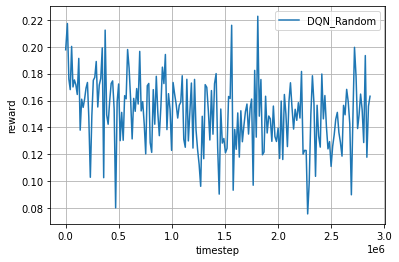

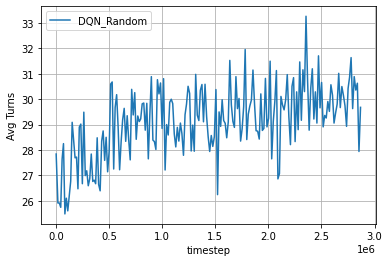

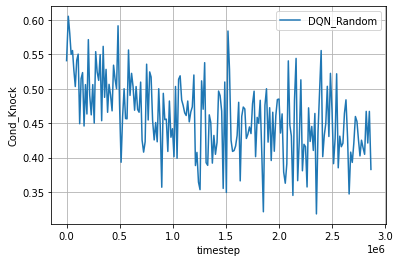

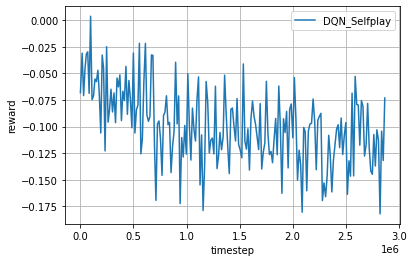

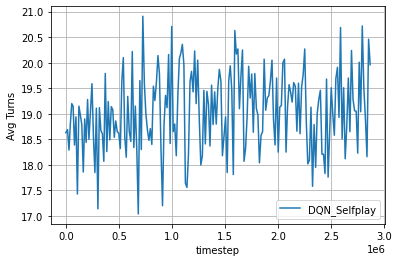

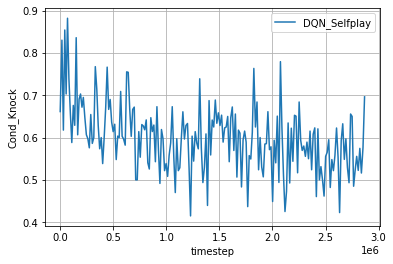

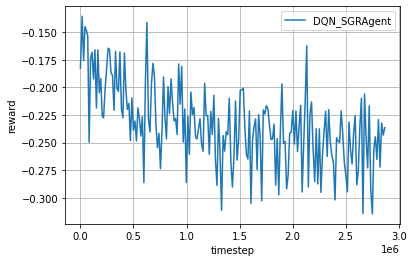

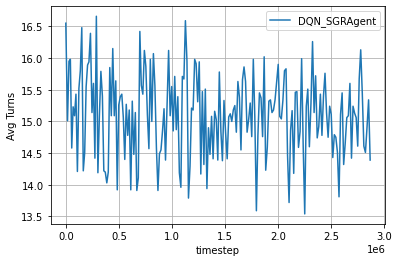

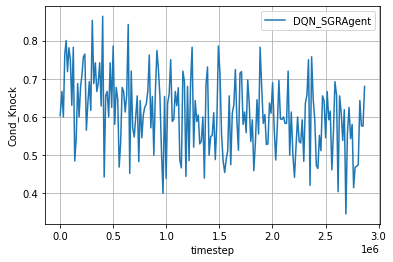

In [ ]:
# Save model prior to training
save_dir = 'models/dqn/random/{}'.format(dqn_model_name)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
state_dict = agent.get_state_dict()
torch.save(state_dict, os.path.join(save_dir, 'model_pretrain.pth'))

max_reward_rand, max_reward_self, max_reward_sgr = -1, -1, -1
max_knock_rand, max_knock_self, max_knock_sgr = 0, 0, 0

# Training Loop
for episode in range(episode_num):

    # Generate data from the environment
    trajectories, _ = env.run(is_training=True)

    # Feed transitions into agent memory, and train the agent
    for ts in trajectories[0]:
        agent.feed(ts)

    # Evaluate the performance.
    if episode % evaluate_every == 0:
        print('\n----------------------------------------------------------------------\n')
        print('Random:')
        reward_rand = tournament(random_env, evaluate_num)[0]
        actions_rand = tournament2(random_env, evaluate_num)
        logger_rand.log_performance2(env.timestep, reward_rand, actions_rand)
        print('\nSelfplay:')
        reward_self = tournament(selfplay_env, evaluate_num)[0]
        actions_self = tournament2(selfplay_env, evaluate_num)
        logger_self.log_performance2(env.timestep, reward_self, actions_self)
        print('\nSGRAgent:')
        reward_sgr = tournament(SGRAgent_env, evaluate_num)[0]
        actions_sgr = tournament2(SGRAgent_env, evaluate_num)
        logger_sgr.log_performance2(env.timestep, reward_sgr, actions_sgr)
        
        # save best reward model for each environment
        if reward_rand > max_reward_rand:
            max_reward_rand = reward_rand
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand.pth'))

        if reward_self > max_reward_self:
            max_reward_self = reward_self
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self.pth'))

        if reward_sgr > max_reward_sgr:
            max_reward_sgr = reward_sgr
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr.pth'))
        
        # save best knock model for each environment
        Cond_Knock = actions_rand['Knock'] / actions_rand['Knock_Possible'] if actions_rand['Knock_Possible'] > 0  else 0
        if Cond_Knock > max_knock_rand:
            max_knock_rand = Cond_Knock
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_rand_knock.pth'))

        Cond_Knock = actions_self['Knock'] / actions_self['Knock_Possible'] if actions_self['Knock_Possible'] > 0  else 0
        if Cond_Knock > max_knock_self:
            max_knock_self = Cond_Knock
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_self_knock.pth'))

        Cond_Knock = actions_sgr['Knock'] / actions_sgr['Knock_Possible'] if actions_sgr['Knock_Possible'] > 0  else 0
        if Cond_Knock > max_knock_sgr:
            max_knock_sgr = Cond_Knock
            state_dict = agent.get_state_dict() 
            torch.save(state_dict, os.path.join(save_dir, 'model_sgr_knock.pth'))

# Close files in the logger
logger_rand.close_files()
logger_self.close_files()
logger_sgr.close_files()

# Plot the learning curve
logger_rand.plot2('DQN_Random')
logger_self.plot2('DQN_Selfplay')
logger_sgr.plot2('DQN_SGRAgent')

# Save model
state_dict = agent.get_state_dict() 
torch.save(state_dict, os.path.join(save_dir, 'model_posttrain.pth'))

#### Training Plots

###### Random

In [ ]:
tournament2(random_env, evaluate_num)

{'Avg Turns': 30.13, 'Gin': 5, 'Knock': 67, 'Knock_Possible': 186, 'Other': 28}

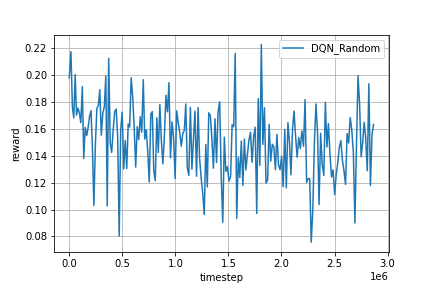

In [ ]:
Image(log_dir + '/rand_fig.png')

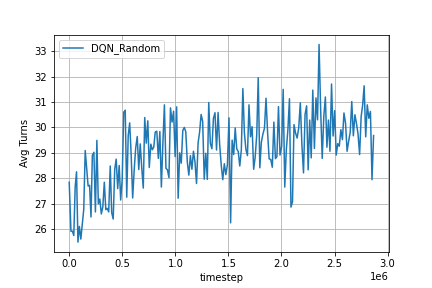

In [ ]:
Image(log_dir + '/rand_fig2.png')

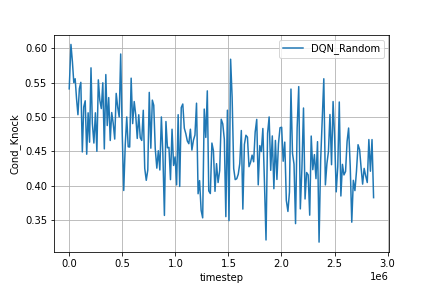

In [ ]:
Image(log_dir + '/rand_fig3.png')

###### Selfplay

In [ ]:
tournament2(selfplay_env, evaluate_num)

{'Avg Turns': 19.39, 'Gin': 2, 'Knock': 34, 'Knock_Possible': 64, 'Other': 64}

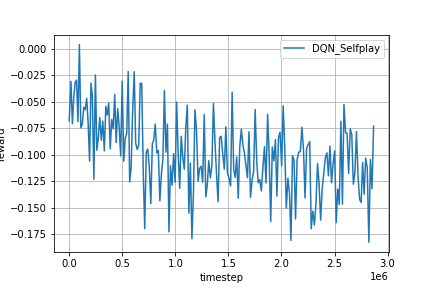

In [ ]:
Image(log_dir + '/self_fig.png')

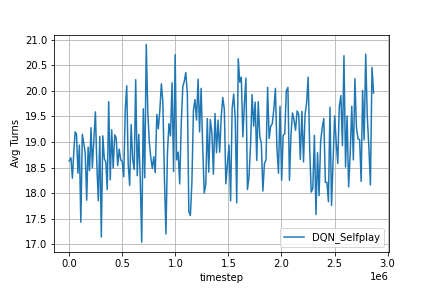

In [ ]:
Image(log_dir + '/self_fig2.png')

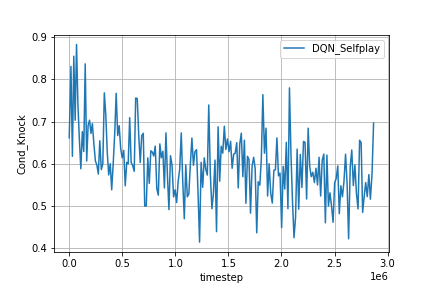

In [ ]:
Image(log_dir + '/self_fig3.png')

###### SGRAgent

In [ ]:
tournament2(SGRAgent_env, evaluate_num)

{'Avg Turns': 14.04, 'Gin': 0, 'Knock': 20, 'Knock_Possible': 31, 'Other': 80}

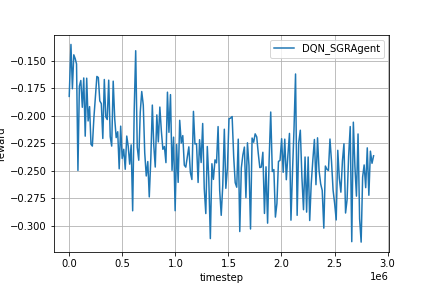

In [ ]:
Image(log_dir + '/sgr_fig.png')

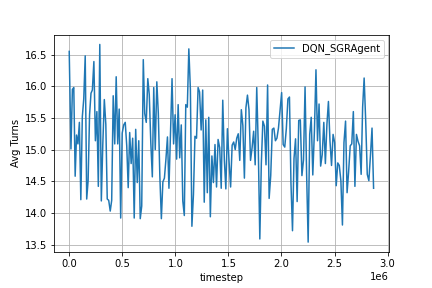

In [ ]:
Image(log_dir + '/sgr_fig2.png')

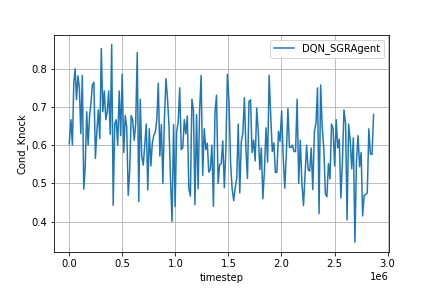

In [ ]:
Image(log_dir + '/sgr_fig3.png')

# Misc.

## Weight Comparison

In [ ]:
model_dqn_pre = torch.load('models/dqn/random/{}/model_pretrain.pth'.format(dqn_model_name), map_location='cpu')
model_dqn_post = torch.load('models/dqn/random/{}/model_posttrain.pth'.format(dqn_model_name), map_location='cpu')
model_q_estim_pre = model_dqn_pre['dqn_q_estimator']
model_target_estim_pre = model_dqn_pre['dqn_target_estimator']
model_q_estim_post = model_dqn_post['dqn_q_estimator']
model_target_estim_post = model_dqn_post['dqn_target_estimator']

In [ ]:
weights_q_estim_pre = model_q_estim_pre['fc_layers.5.weight'].flatten().tolist()
weights_target_estim_pre = model_target_estim_pre['fc_layers.5.weight'].flatten().tolist()

In [ ]:
weights_q_estim_post = model_q_estim_post['fc_layers.5.weight'].flatten().tolist()
weights_target_estim_post = model_target_estim_post['fc_layers.5.weight'].flatten().tolist()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
dqn_model = 'Q Estimator'
weights_pre = weights_q_estim_pre
weights_post = weights_q_estim_post

In [ ]:
dqn_model = 'Target Estimator'
weights_pre = weights_target_estim_pre
weights_post = weights_target_estim_post

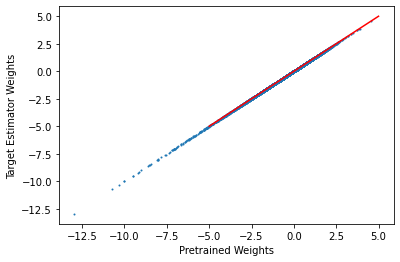

In [ ]:
# s = np.subtract(weights_post, weights_pre) + 1
fig = plt.figure()
plt.scatter(weights_pre, weights_post, s=1)
plt.xlabel('Pretrained Weights')
plt.ylabel('{} Weights'.format(dqn_model))
x = np.linspace(-5,5,100)
plt.plot(x, x, '-r')
plt.show()